# Return on Investment of US College Majors

    Created By: Mijail Mariano, Chenchen Feng, & David Schneemann

    October 2022
    
----

In [1]:
%matplotlib inline
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 200

# disabling warning messages
import warnings
warnings.filterwarnings("ignore")

# notebook dependencies
import pandas as pd
# pd.set_option('display.max_rows', None, 'display.max_columns', None)
import numpy as np

#visualizations
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style = "darkgrid")

# math modules
from math import sqrt
import math
import scipy.stats as stats

# sklearn data science library
from sklearn.metrics import mean_squared_error
from scipy.stats.mstats import winsorize

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.cluster import KMeans

from sklearn.model_selection import train_test_split

from sklearn.preprocessing import RobustScaler, PolynomialFeatures
from sklearn.linear_model import LinearRegression, LassoLars, TweedieRegressor, LogisticRegression

from sklearn.decomposition import PCA 
from sklearn.metrics import mean_squared_error

from sklearn.feature_selection import RFE
from sklearn.feature_selection import RFECV
from sklearn.model_selection import StratifiedKFold

# .py files
import acquire
import prepare
import model

# image module
from IPython.display import Image

## <u>Executive Summary</u>

This group capstone project utilizes unsupervised clustering techniques in order to predict 5-year Return on Investment (ROI) for a given college major. We collected data for all accredited US colleges from the US Department of Education College Scorecard database and University of Minnesota's IPUMS database spanning the academic year periods 2017 - 2019.  <br>

Our initial dataset contained 225,000 records and 3000+ features. <br>
Our final dataset used for modeling contained just over 71,000 records and 57 features.  <br>

Our clusters were created utilizing advanced clustering techniques including K-best, Recursive Feature Elimination with cross-validation, and a unique process of variable classification through clustering in order to refine our features and associated clusters to be most effective. These methods combined to produce 6 unique clusters which we used to model with. In total, 3 algorithms were tested and 12 models were deployed. Our best results were produced by our Ordinary Least Squares Model with Principal Component Analysis. This model performed 5% better than our baseline. 

## <u>Project Description</u>

The benefits of attending college* and its potential costs are primary topics of conversation for young people today. The actual return on investment of such an endeavor is difficult to quantify and leaves prospective students guessing when choosing a college and degree to pursue. This analysis hopes to provide clarity for students when making these key decisions about their future.

In order to more accurately predict return on investment, we will analyze the attributes (features) of college majors. We gathered data for all US colleges from the US Department of Education College Scorecard and US Census earnings data provided by University of Minnesota's IPUMS database. 

Our chosen dataset includes all gathered data for the academic years of 2017-2018 and 2018-2019 and earnings data from 2019 spanning 1% of the US population. 
In total, our initial dataset contains 225,000 records and 3000+ features. 
Our final cleaned and prepared dataset contains roughly the same number of records but narrows to 57 key features. 

Our approach to this project involves clustering by groups of these features in order to best predict return on investment while simultaneously providing depth and insight into what features most affect return on investment and overall college outcomes.

\* **Note:**   <br>
The terms "institution" and "college" are used interchangeably within this report and ancillary documents

## <u>Project Goal</u>

Our key project goal was to predict a return on investment (ROI) for US college undergraduate majors. We use U.S. Department of Education College Scorecard data to test and identify statistically significant metrics in order to predict a "cost-to-earnings" ratio of college majors' return on investment at the 5-, 10-, and 20-year post-graduation periods.

We explore how potential variables within the data produce certain return on investment ratios aand provide insight into why and how these factors contribute to our target ROI variable. With this information and the following recommendations, we intend to provide current and prospective students a greater understanding of the value and trade-offs tied to a given college major and its potential career paths.

----
### The Target Variable, ROI, Explained 

Return on Investment (ROI) is a standard performance measure that evaluates the efficiency or profitability of an investment. This measure is expressed as a percentage and should be compared against other ROIs in order to compare potential value of a given investment.

In simple terms, ROI tells you how much money you've made (or lost) off an investment after accounting for its cost.
In this case, money made is equivalent to the net earnings with a degree. Its cost is equivalent to the "Net Cost of Investment" which represents both Net College Cost and the Potential Earnings with HS Diploma constant.

----
### <u>Exploratory Questions</u>

Going into this study, we had several hypothesis and questions that we wanted to ask of our data. Although not an exhaustive list of the potential factors that can determine an undergraduate student's return on investment - we nonetheless felt these questions provided an intial foundation for exploration data anlysis and subsequently helped to surface the insights we highlight in this project.

* **Are there return on investment differences across undergraduate majors as measured by our study's ROI target variable? (project focal question)**

* What, if any, differences are there across the initial college information variables?

* Does a college's total tuition revenue impact attending students' ROI?

* Do faculty salaries play a role in their student's potential college ROI?

* Are there ROI differences across institution control types (e.g., private, public, and foreign institutions)?

* Does the total number of students attending any given university impact college major return on investment?

* Are there differences across university location/United States regions and students' college return on investment?

* How does a college's admissision rate and required admission test scores play a role in students' return on investment?

* Are there differences across socioeconomic factors such as students' family incomes and their potential college return on investment?

----

### <u>Key Insights</u>

**(mm suggestion) maybe bring to bottom - post-analysis? or leave solely on README page/final whitepaper/final presentation**

1. Although there are significant jumps in 5, 10, and 20 year ROI - the distribution across the dataset appears to be very similar over time.

2. There are ~4 humanities w/ teaching focus majors - that within the initial 5YR post-graduation mark have a negative return on investment :
 - Library Sciences
 - Education Administration and Teaching
 - Theology and Religious Vocations
 - Public Affairs, Policy, and Social Work

3. Within the Universities/Colleges studied, the percentage of entering first-time, full-time students can have an impact on a student’s future return on investment.

4. A University or College’s geographical location can have an impact on an undergraduate student’s potential earnings over a 5-10 year period. (edited) 

-------------
## Data Acquisition & Preparation

**<u>Data Acquisition Highlights:</u>**

- The "acquire.py" file pulls selected features from FieldOfStudyData1718_1819_PP and joins them with MERGED2018_19_PP

- We then merge this dataset with 2017, 2018, and 2019 earnings data from the University of Minnesotta IPUMS database

- After an initial import and clean - the resulting dataset returns ~72,000 unique total records and ~140 attributes


**<u>Data Context</u>**

- Our acquired and prepared dataset contains information of ~72,000 earned undergraduate degrees spanning ~7200 colleges across 50 states and 8 U.S. territories


- Each individual record represents one four-year (undergraduate) degree by major conferred by the college or institution studied in this analysis

- In the process of exploring and setting initial hypotheses, we wanted to better understand the data through investigating explanatory features such as category of major, region, institution_control (whether a college is public or private), and standardized test scores. What follows is our data summation through visualization

In [2]:
# from the acquire.py file - call and assign the Bachelor Degree records table as Pandas dataframe

df = acquire.get_bach_df()
df.head(3)

dataframe shape: (71901, 139)


,UNITID,INSTNM_x,CONTROL_x,STABBR,ZIP,CITY,REGION,OPEFLAG,PREDDEG,SCH_DEG,...,PCIP45,PCIP46,PCIP47,PCIP48,PCIP49,PCIP50,PCIP51,PCIP52,PCIP54,UGNONDS
0,100654.0,Alabama A & M University,Public,AL,35762,Normal,5.0,1.0,3.0,3.0,...,0.0355,0.0,0.0,0.0,0.0,0.0237,0.0,0.1578,0.0,153.0
1,100654.0,Alabama A & M University,Public,AL,35762,Normal,5.0,1.0,3.0,3.0,...,0.0355,0.0,0.0,0.0,0.0,0.0237,0.0,0.1578,0.0,153.0
2,100654.0,Alabama A & M University,Public,AL,35762,Normal,5.0,1.0,3.0,3.0,...,0.0355,0.0,0.0,0.0,0.0,0.0237,0.0,0.1578,0.0,153.0


----
**<u>Data Preparation Highlights:</u>**

Utilizing the project's "prepare.py" file to conduct the following steps:

- Reads and Merges earnings data from IPUMS dataset
- Converts select variables to integers for optimization
- Cleans variables, including dropping numerous extraneous features
- Conduct feature engineering to: 

    - condense initial undergraduate majors into predominant "major categories" 
    - creating university population of family income brackets
    - engineering our target variable ROI (5, 10, & 20 years) by earnings data and net price variables <br></br>

- Splits prepared df into train, validate, test 
- Handles outliers through a process called "capping" via the "winsorize" method
- Manual imputation of select features
- Utilizes an iterative imputer to programmatically handle remaining missing values

In [3]:
# Importing and cleaning the initial Bachelor Degree dataset

df = prepare.clean_college_df(df)
df = prepare.clean_high_percentage_nulls(df)
df = prepare.obtain_target_variables(df)

dataframe shape: (71901, 117)
dataframe shape: (71422, 127)


In [4]:
# Creating population count of family income brackets by institution

income_0_30000 = [
'other_fam_income_0_30000',
 'private_fam_income_0_30000',
 'program_fam_income_0_30000',
 'pub_fam_income_0_30000']

income_30001_48000 = [
 'other_fam_income_30001_48000',
 'private_fam_income_30001_48000',
 'program_fam_income_30001_48000',
 'pub_fam_income_30001_48000']

income_48001_75000 = [
'other_fam_income_48001_75000',
'private_fam_income_48001_75000',
'program_fam_income_48001_75000',
'pub_fam_income_48001_75000']

income_75001_110000 = [
'other_fam_income_75001_110000',
'private_fam_income_75001_110000',
'program_fam_income_75001_110000',
'pub_fam_income_75001_110000']

income_over_110000 = [
'other_fam_income_over_110000',
'private_fam_income_over_110000',
'program_fam_income_over_110000',
'pub_fam_income_over_110000']

In [5]:
# Additional transformation including feature engineering and imputing missing values

df = prepare.create_fam_income_columns(df)
df = prepare.impute_avg_net_price(df)
df = prepare.impute_debt(df)

dataframe shape: (71422, 112)


In [6]:
# Creating region category feature from `state_post_code`

df['us_region'] = df.apply(lambda row: prepare.label_states(row), axis=1)

In [7]:
# Splitting the data

train, validate, test = prepare.split_data(df)

train shape: (39995, 113)
validate shape: (17142, 113)
test shape: (14285, 113)


In [8]:
# Capping outliers on exploration and modeling datasets

train = prepare.percentile_capping(train, 0.1, 0.1)
validate = prepare.percentile_capping(validate, 0.1, 0.1)
test = prepare.percentile_capping(test, 0.1, 0.1)

In [9]:
# Running imputer function on train dataset

train_imputed = prepare.train_iterative_imputer(train)

In [10]:
# Performing final imputation on validate and test datasets

validate_imputed, test_imputed = prepare.impute_val_and_test(train, validate, test)

In [11]:
# Checking shape on our samples to confirm appropriate split

print('Imputed Train shape: {}.'.format(train_imputed.shape))
print('Imputed Validate shape: {}.'.format(validate_imputed.shape))
print('Imputed Test shape: {}.'.format(test_imputed.shape))

Imputed Train shape: (39995, 113).
Imputed Validate shape: (17142, 113).
Imputed Test shape: (14285, 113).


### **Distribution of Target Return on Investment Variables across 5-, 10-, and 20-year periods**

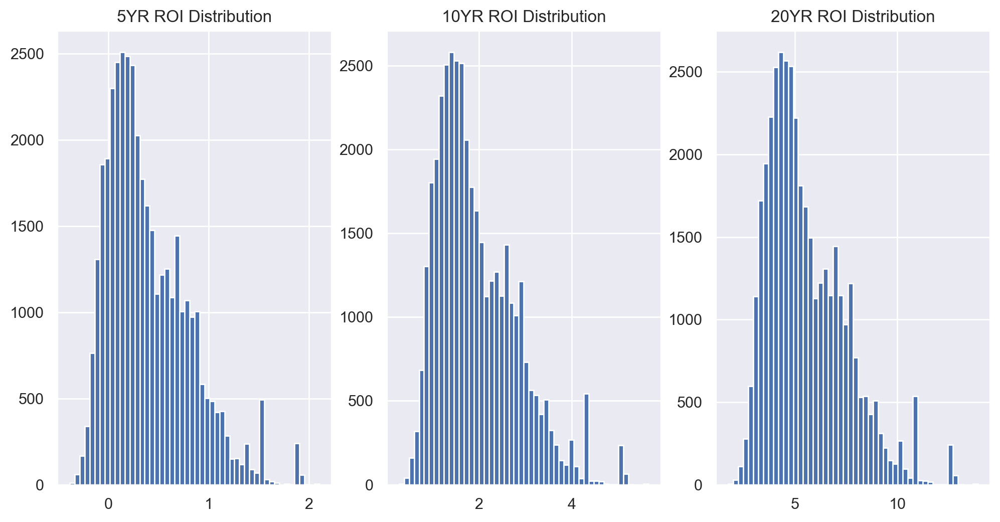

In [12]:
# Visualizing distribution of ROI target variable comparing 5, 10, & 20 year periods
acquire.plot_target_distributions(train_imputed)

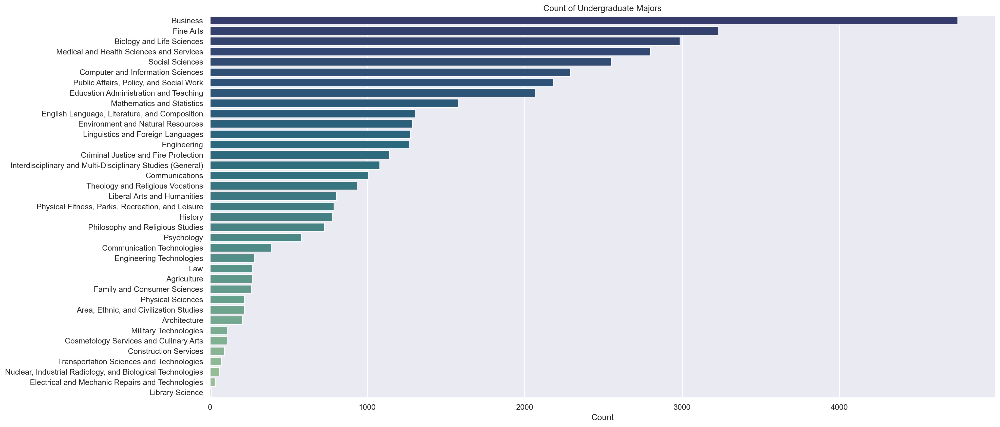

In [13]:
# Viewing total count of undergraduate degrees by major category

acquire.plot_majors_count(train_imputed)

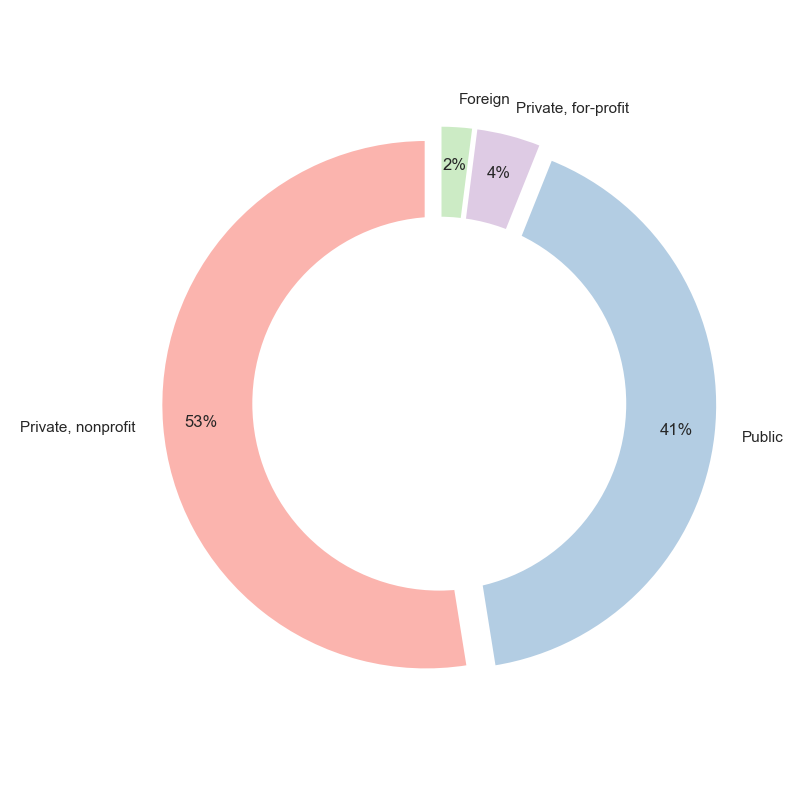

In [14]:
# visualizing the percentage of institution control in the dataset

acquire.plot_institution_control(train_imputed)

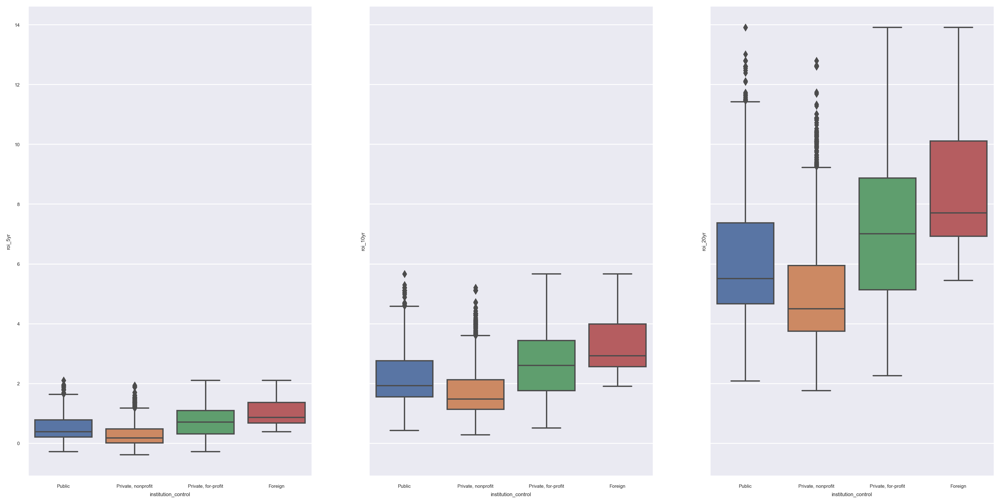

In [15]:
# Boxplot representing the quartile ranges of all 4 institution types expressed over 3 ROI timespans
figure, axes = plt.subplots(1,3, sharey = True, figsize=(20,10))
    
sns.boxplot(x='institution_control', y='roi_5yr', data=train_imputed, ax=axes[0])
sns.boxplot(x='institution_control', y='roi_10yr', data=train_imputed, ax=axes[1])
sns.boxplot(x='institution_control', y='roi_20yr', data=train_imputed, ax=axes[2])

plt.show()

### **Question 1. Does the popular majors have higher ROI than unpopular majors?**

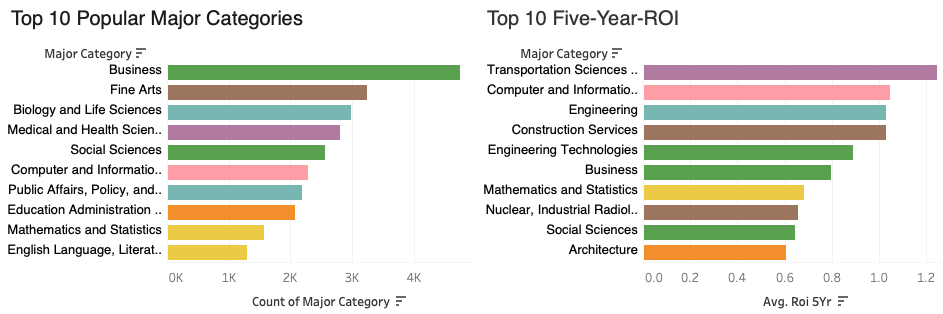

In [16]:
# Calling Tableau visual within report
Image(filename='cc_image01.png')

#### Answer: **False** 
    
    For the top 10 ROI majors. Only business, social sciences, computer and information sciences and mathematics and statistics, total four majors are on the popular list. Transportation sciences and technologies, construction services, nuclear industrial radiology and biological technologies and architecture, total four majors are on the least ten list.


### **Question 2. Are the more expensive school the better?**

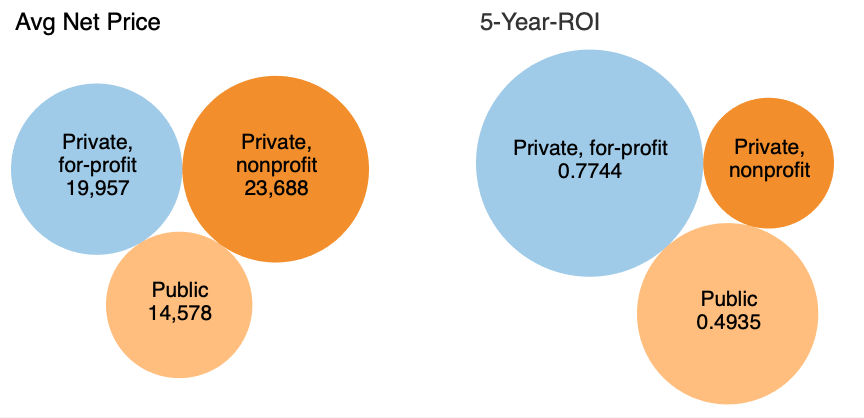

In [17]:
# Calling Tableau visual within report
Image(filename = 'cc_image02.png')

#### Answer: **False** 
    
    Private non-profit has the highest net price but has the lowest 5-Year-ROi.

-----------------------------------------------------------------------------------------------------------
### Data Summary

#### Key Takeaways: 
`` - Business, Fine Arts, and Biology/Medical Degrees are most prevalent in the US today `` <br>
`` - The majority of insitutions within the US are Private Non-profits with Public representing a large minority `` <br>
`` - Distribution of ROI is the same across ROI timespans, we predominantly utilize 5-yr ROI for analysis and modeling `` <br>
`` - The different institution types express disparate ROI results over time, with increased separation as time goes on `` <br>
##### I will now implement these and other features within my clustering exploration and analysis


------------
# Hypothesis Testing and Explanatory Analysis

##### The following table represents statistical tests for all relevant features used in clustering and modeling

**Note:** <br>
All individual features utilized within our clusters are visualized and statistically tested in the Appendix at the end of this Final Report.

| Feature                      | Statistic                         | P-Value           | Statistical Significance Result  |
| ----                         | ----                              | ----              | ----                             |
| institution_control          | f: 2896.378                       | 0.0               | Reject the Null (Significant)    |
| major_category               | f: 2157.765                       | 0.0               | Reject the Null (Significant)    |
| us_region                    | f: 122.438                        | 0.0               | Reject the Null (Significant)    |
| income_48001_75000           | f: 443.426                        | 0.0               | Reject the Null (Significant)    |
| avg_faculty_salary           | r: -0.0306                        | 2.061e-09         | Reject the Null (Significant)    |
| full_time_net_tuition_revenue| r: -0.3579                        | 0.0               | Reject the Null (Significant)    |
| admission_rate               | r: 0.0605                         | 1.078e-19         | Reject the Null (Significant)    |
| avg_sat_admitted             | r: -0.01514                       | 6.748e-179        | Reject the Null (Significant)    |
| share_entering_students_first_ft   | f: 225.56                   | 0.0               | Reject the Null (Significant)    |
| share_of_part_time           | f: 40.3646                        | 0.0               | Reject the Null (Significant)    |
| undergraduate_number_pell_grant_federal_loan   | f: 1282.7326     | 0.0               | Reject the Null (Significant)    |

----
### **Data Preprocessing**

In [18]:
# retrieve created "first-time, full-time student bins" column

train, validate, test = model.get_share_bins(train_imputed, validate_imputed, test_imputed)

train shape: (39995, 116)
validate shape: (17142, 116)
test shape: (14285, 116)


In [19]:
# create dummy datasets w/passed categorical columns

train_dummy, validate_dummy, test_dummy = model.get_dummy_dataframes(train, validate, test)

train shape: (39995, 173)
validate shape: (17142, 173)
test shape: (14285, 173)


### **Scaling Continuous Variables**

In [20]:
# identify continuous variables to scale - exclusive of target variables

cont_lst = train_dummy.select_dtypes(exclude = ["object", "category", "uint8", "int64", "bool"]).columns.tolist()

target_lst = [ 
        "roi_5yr",
        "roi_10yr",
        "roi_20yr",
        "pct_roi_5yr",
        "pct_roi_10yr",
        "pct_roi_20yr",
        "2017",                                               
        "2018",                                                   
        "2019",
        "Grand Total",
        "avg_net_price"
        ]

# final continuous variables list
cont_lst = [col for col in cont_lst if col not in target_lst]

In [21]:
# transforming datasets

# creating the scaler
scaler = RobustScaler()

# fit scaler on the training dataset
scaler.fit(train_dummy[cont_lst])

# transform dummy datasets
train_dummy[cont_lst] = scaler.transform(train_dummy[cont_lst])
validate_dummy[cont_lst] = scaler.transform(validate_dummy[cont_lst])
test_dummy[cont_lst] = scaler.transform(test_dummy[cont_lst])

# give new dataframe names
train_scaled = train_dummy
validate_scaled = validate_dummy
test_scaled = test_dummy

# non-dummy datasets (can be used for future comparison purposes)
train_imputed[cont_lst] = scaler.transform(train_imputed[cont_lst])
validate_imputed[cont_lst] = scaler.transform(validate_imputed[cont_lst])
test_imputed[cont_lst] = scaler.transform(test_imputed[cont_lst])

# inspect the dataset
train_scaled.head()

,unit_id_institution,college_name,state_post_code,zip_code,city,region_ipeds,title_IV_eligibility,pred_degree,pred_degree_0and4,degree_name,...,us_region_west_pacific,admission_rate_binned_very_competitive,admission_rate_binned_somewhat_competitive,admission_rate_binned_competitive,admission_rate_binned_average_acceptance,admission_rate_binned_above_average_acceptance,SAT_binned_average_sat,SAT_binned_above_average_sat,SAT_binned_competitive_sat,SAT_binned_very_competitive_sat
25530,0.443437,University of Memphis,TN,38152,Memphis,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,False,True,False,True,False,False
53875,0.402047,Limestone University,SC,29340-3799,Gaffney,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,False,False,False,True,False,False,False
42932,0.563267,Texas State University,TX,78666,San Marcos,0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,True,False,False,True,False,False
45495,-0.732042,Judson University,IL,60123-1498,Elgin,-0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,True,False,True,False,False,False
25003,0.078220,Yeshiva University,NY,10033-3299,New York,-0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,True,False,False,False,False,False,False,True


-----------------------------------------------------------------------------------------------------------
# Clustering Creation

### 1. Admission Rate
**Features:** \
    - income_48001_75000 \
    - admission_rate ==> admission_rate_binned_*


### 2. Institution Control
**Features:** \
    - admission_rate \
    - institution_control ==> institution_control_*


### 3. University by US Region
**Features:** \
    - full_time_net_tuition_revenue \
    - us_region ==> us_region_*


### 4. Share of First-time, Full-time Students
**Features:** \
    - avg_faculty_salary \
    - share_entering_students_first_ft ==> share_entering_ft_binned_*


### 5. College Majors
**Features:** \
    - share_of_part_time \
    - major_category_**


### 6. SAT Score
**Features:** \
    - undergraduate_number_pell_grant_federal_loan \
    - avg_sat_admitted ==> SAT_binned_*



\* = expresses features extrapolated out via binning \
\** = expresses features that are extrapolated out via dummy vars

-----------------------------------------------------------------------------------------------------------
## Cluster 1: Admission Rate 

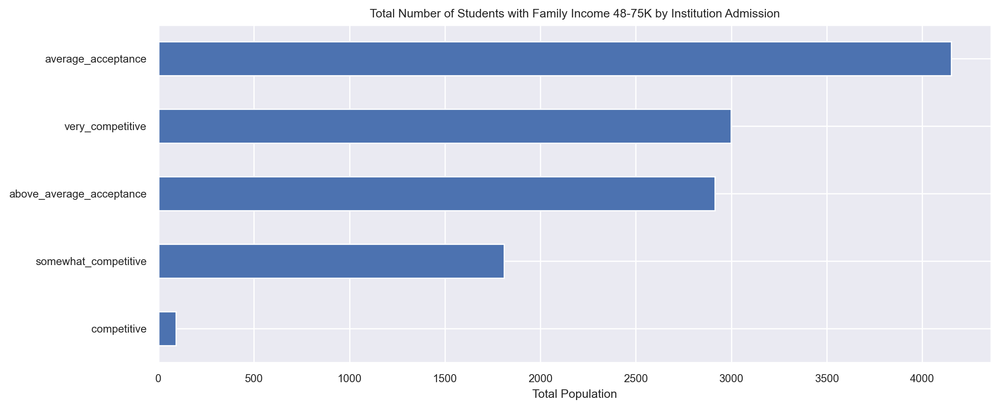

In [22]:
# Viewing institution admission rate class by student population with family income range 48-75K 
plt.figure(figsize = (12,5))
sns.set(font_scale = 0.8)

train.groupby(["admission_rate_binned"])['income_48001_75000'].sum().sort_values().plot(kind = "barh")

plt.title("Total Number of Students with Family Income 48-75K by Institution Admission")
plt.xlabel("Total Population")
plt.ylabel(None)
plt.show()

In [23]:
# setting features to cluster on 

X_admission = train_scaled[[
'income_48001_75000',
'admission_rate_binned_very_competitive',	
'admission_rate_binned_somewhat_competitive',	
'admission_rate_binned_competitive',	
'admission_rate_binned_average_acceptance',	
'admission_rate_binned_above_average_acceptance'
    ]]

# validate df
X_val = validate_scaled[[
'income_48001_75000',
'admission_rate_binned_very_competitive',	
'admission_rate_binned_somewhat_competitive',	
'admission_rate_binned_competitive',	
'admission_rate_binned_average_acceptance',	
'admission_rate_binned_above_average_acceptance'
    ]]

# test df
X_test = test_scaled[[
'income_48001_75000',
'admission_rate_binned_very_competitive',	
'admission_rate_binned_somewhat_competitive',	
'admission_rate_binned_competitive',	
'admission_rate_binned_average_acceptance',	
'admission_rate_binned_above_average_acceptance'
    ]]

X_admission.head()

,income_48001_75000,admission_rate_binned_very_competitive,admission_rate_binned_somewhat_competitive,admission_rate_binned_competitive,admission_rate_binned_average_acceptance,admission_rate_binned_above_average_acceptance
25530,1.429688,False,False,False,False,True
53875,-0.062500,True,False,False,False,False
42932,1.859375,False,False,False,True,False
45495,-0.218750,False,False,False,True,False
25003,-0.242188,False,True,False,False,False


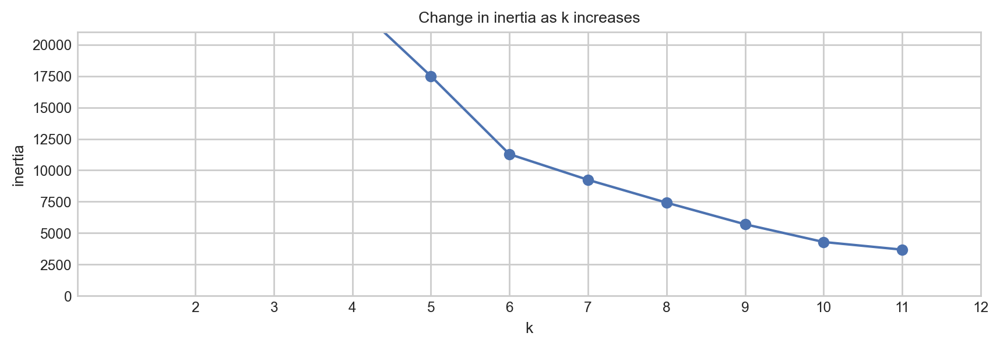

In [24]:
# KMeans Elbow-method

with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize=(10, 3))
    pd.Series({k: KMeans(k, random_state = 123).fit(X_admission).inertia_ for k in range(1, 12)}).plot(marker = 'o')
    plt.xticks(range(2, 13))
    
    plt.ylim(0, 21000)
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

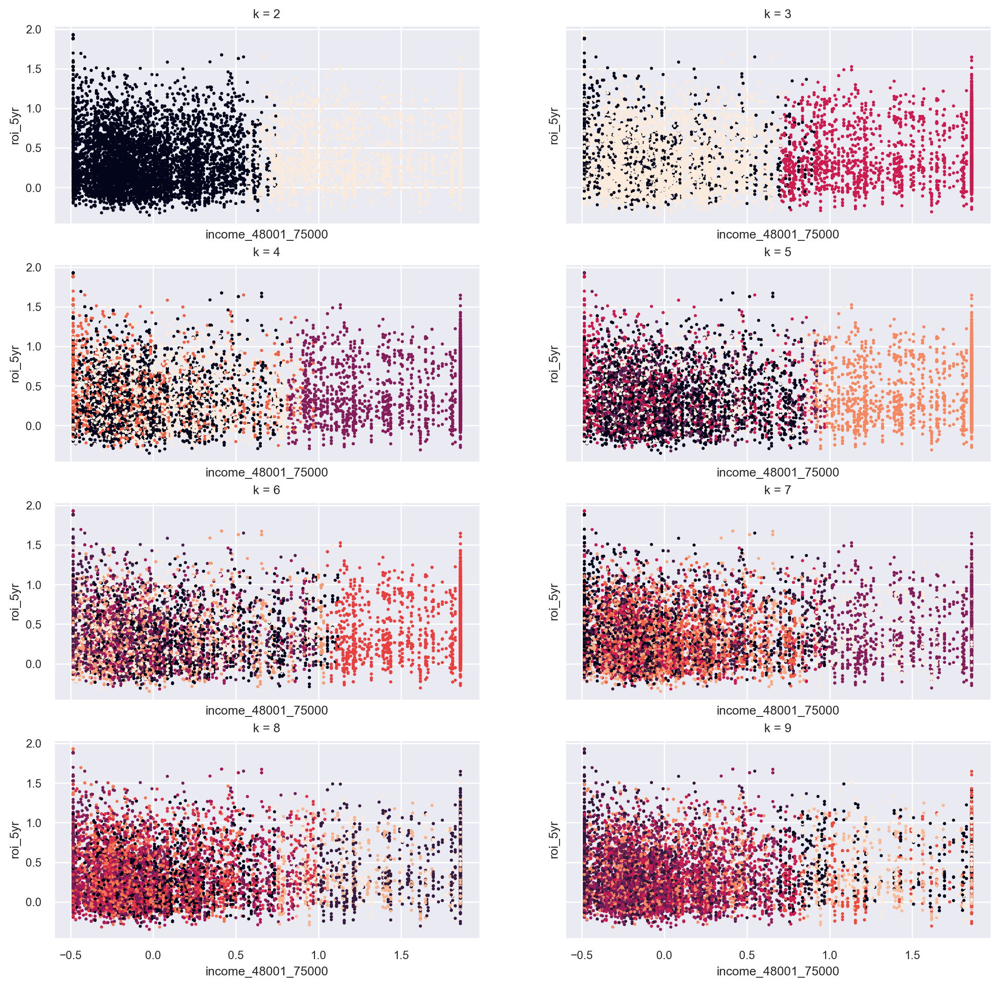

In [25]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(4, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 13)):
    
    X1 = X_admission.sample(10000, random_state = 123)

    # creating and fitting KMeans
    clusters = KMeans(k, random_state = 123).fit(X1).predict(X1)

    X1["roi_5yr"] = train_scaled["roi_5yr"]

    ax.scatter(
        X1["income_48001_75000"],
        X1["roi_5yr"],
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'income_48001_75000', ylabel = 'roi_5yr')

In [26]:
# initial fitting of KMeans cluster

kmeans = KMeans(n_clusters = 5, random_state = 123)
kmeans.fit(X_admission)

train_clusters = kmeans.predict(X_admission)

In [27]:
# creating cluster for ea. dataset 

train_admission_clusters = kmeans.predict(X_admission)
val_admission_clusters = kmeans.predict(X_val)
test_admission_clusters = kmeans.predict(X_test)

# viewing cluster samples
pd.DataFrame(train_admission_clusters).rename(columns = {0: "Cluster Sample"}).sample(10, random_state = 123)

,Cluster Sample
21417,4
28667,0
7477,1
24935,1
24966,1
7142,1
30603,1
7930,2
31203,0
1107,1


In [28]:
# adding clusters back to original datasets

train_scaled["admission_clusters_5yr"] = train_admission_clusters
validate_scaled["admission_clusters_5yr"] = val_admission_clusters
test_scaled["admission_clusters_5yr"] = test_admission_clusters

train_scaled.head()

,unit_id_institution,college_name,state_post_code,zip_code,city,region_ipeds,title_IV_eligibility,pred_degree,pred_degree_0and4,degree_name,...,admission_rate_binned_very_competitive,admission_rate_binned_somewhat_competitive,admission_rate_binned_competitive,admission_rate_binned_average_acceptance,admission_rate_binned_above_average_acceptance,SAT_binned_average_sat,SAT_binned_above_average_sat,SAT_binned_competitive_sat,SAT_binned_very_competitive_sat,admission_clusters_5yr
25530,0.443437,University of Memphis,TN,38152,Memphis,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,True,False,True,False,False,3
53875,0.402047,Limestone University,SC,29340-3799,Gaffney,0.25,0.0,0.0,0.0,Bachelors Degree,...,True,False,False,False,False,True,False,False,False,1
42932,0.563267,Texas State University,TX,78666,San Marcos,0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,True,False,False,True,False,False,3
45495,-0.732042,Judson University,IL,60123-1498,Elgin,-0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,True,False,True,False,False,False,0
25003,0.078220,Yeshiva University,NY,10033-3299,New York,-0.50,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,False,False,False,False,False,True,4


In [29]:
# printing average admissions rate by admission cluster

unique_clusters = sorted(train_scaled["admission_clusters_5yr"].unique().tolist())

container = []

for cluster in unique_clusters:
    
    metric = {
    'admission cluster': cluster,
    'admission rate': round(train_scaled[train_scaled["admission_clusters_5yr"] == cluster]["admission_rate"].mean(), 3),
    'min 5YR ROI': round(train_scaled[train_scaled["admission_clusters_5yr"] == cluster]["roi_5yr"].min(), 3),
    'max 5YR ROI': round(train_scaled[train_scaled["admission_clusters_5yr"] == cluster]["roi_5yr"].max(), 3),
    'range of 5YR ROI': round((train_scaled[train_scaled["admission_clusters_5yr"] == cluster]["roi_5yr"].max() - train_scaled[train_scaled["admission_clusters_5yr"] == cluster]["roi_5yr"].min()), 2),
    'average 5YR ROI': round(train_scaled[train_scaled["admission_clusters_5yr"] == cluster]["roi_5yr"].mean(), 3)
    }

    container.append(metric)

cluster_description = pd.DataFrame(container).sort_values(by = "average 5YR ROI", ascending = False).reset_index(drop = True)
cluster_description

,admission cluster,admission rate,min 5YR ROI,max 5YR ROI,range of 5YR ROI,average 5YR ROI
0,2,-0.015,-0.295,2.103,2.40,0.549
1,3,-0.081,-0.339,1.804,2.14,0.431
2,4,-0.344,-0.363,1.930,2.29,0.396
3,1,-0.130,-0.385,1.930,2.32,0.326
4,0,0.373,-0.322,1.930,2.25,0.302


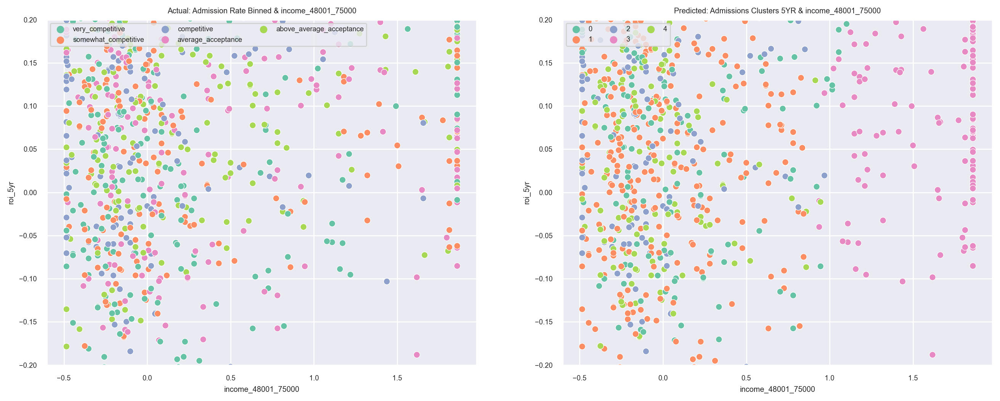

In [30]:
# comparing admissions rate clusters against actual observations

sns.set(font_scale = 0.6)
plt.subplots(1, 2, figsize = (16, 6), sharex = False, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "income_48001_75000",
        y = "roi_5yr",
        data = train_imputed.sample(2000, random_state = 123), 
        hue = "admission_rate_binned",
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3','#a6d854']
)

plt.title("Actual: Admission Rate Binned & income_48001_75000")
plt.legend(loc = 'upper left', ncol = 3)
plt.ylim(-.2, .2)

plt.subplot(122)
sns.scatterplot(
        x = "income_48001_75000",
        y = "roi_5yr",
        data = train_scaled.sample(2000, random_state = 123), 
        hue = "admission_clusters_5yr",
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3','#a6d854']
)

plt.title("Predicted: Admissions Clusters 5YR & income_48001_75000")
plt.legend(loc = 'upper left', ncol = 3)
plt.ylim(-.2, .2)
plt.show()

--------------------------------------------------
## Cluster 2: Institution Control

In [31]:
# setting features to cluster on 

X_control = train_scaled[[
    'admission_rate',
    'institution_control_Foreign',
    'institution_control_Private, for-profit',
    'institution_control_Private, nonprofit',
    'institution_control_Public'
    ]]

# validate df
X_val = validate_scaled[[
    'admission_rate',
    'institution_control_Foreign',
    'institution_control_Private, for-profit',
    'institution_control_Private, nonprofit',
    'institution_control_Public'
    ]]

# test df
X_test = test_scaled[[
    'admission_rate',
    'institution_control_Foreign',
    'institution_control_Private, for-profit',
    'institution_control_Private, nonprofit',
    'institution_control_Public'
    ]]

X_control.head()

,admission_rate,institution_control_Foreign,"institution_control_Private, for-profit","institution_control_Private, nonprofit",institution_control_Public
25530,0.754616,False,False,False,True
53875,-1.195821,False,False,True,False
42932,0.437804,False,False,False,True
45495,0.108844,False,False,True,False
25003,-0.412536,False,False,True,False


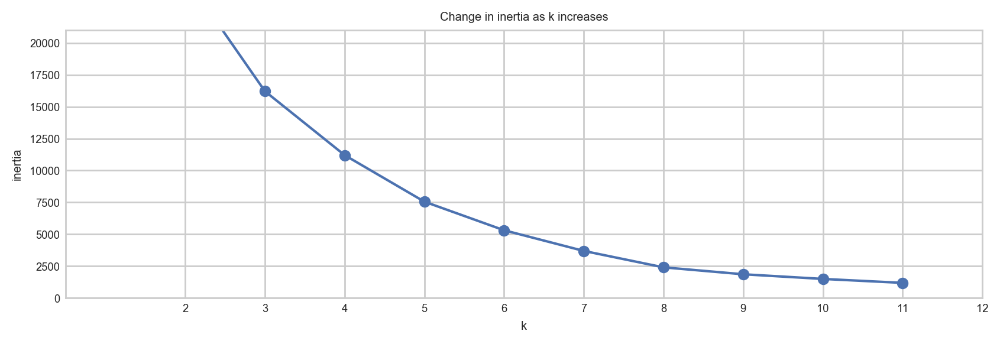

In [32]:
# KMeans Elbow-method

with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize=(10, 3))
    pd.Series({k: KMeans(k, random_state = 123).fit(X_control).inertia_ for k in range(1, 12)}).plot(marker = 'o')
    plt.xticks(range(2, 13))
    
    plt.ylim(0, 21000)
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

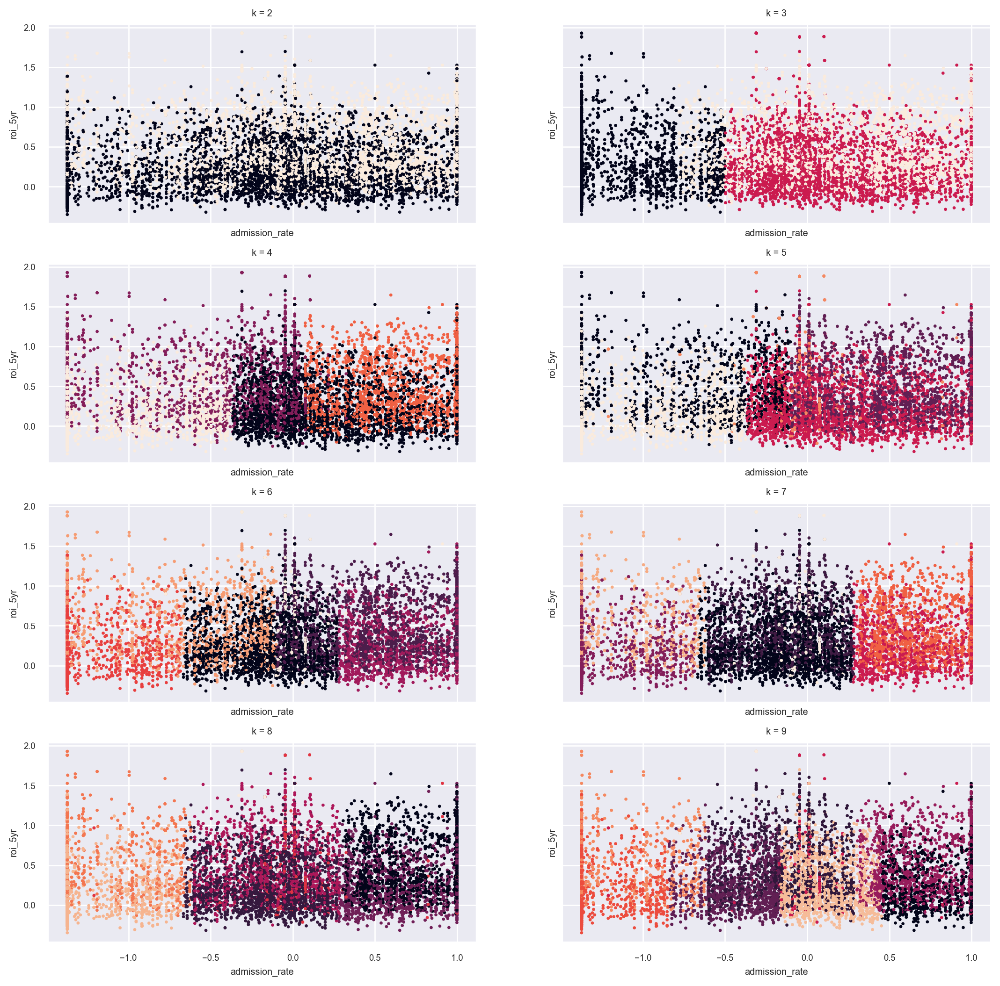

In [33]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(4, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 13)):
    
    X2 = X_control.sample(10000, random_state = 123)

    # creating and fitting KMeans
    clusters = KMeans(k, random_state = 123).fit(X2).predict(X2)

    X2["roi_5yr"] = train_scaled["roi_5yr"]

    ax.scatter(
        X2["admission_rate"],
        X2["roi_5yr"],
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'admission_rate', ylabel = 'roi_5yr')

In [34]:
# fitting of KMeans n_cluster to 3

kmeans = KMeans(n_clusters = 3, random_state = 123)
kmeans.fit(X_control)

train_clusters = kmeans.predict(X_control)

In [35]:
# creating cluster for ea. dataset 

train_control_clusters = kmeans.predict(X_control)
val_control_clusters = kmeans.predict(X_val)
test_control_clusters = kmeans.predict(X_test)

# viewing cluster samples
pd.DataFrame(train_control_clusters).rename(columns = {0: "Cluster Sample"}).sample(10, random_state = 123)

,Cluster Sample
21417,0
28667,0
7477,0
24935,1
24966,0
7142,0
30603,2
7930,1
31203,0
1107,1


In [36]:
# adding clusters back to original datasets

train_scaled["control_clusters_5yr"] = train_control_clusters
validate_scaled["control_clusters_5yr"] = val_control_clusters
test_scaled["control_clusters_5yr"] = test_control_clusters

train_scaled.head()

,unit_id_institution,college_name,state_post_code,zip_code,city,region_ipeds,title_IV_eligibility,pred_degree,pred_degree_0and4,degree_name,...,admission_rate_binned_somewhat_competitive,admission_rate_binned_competitive,admission_rate_binned_average_acceptance,admission_rate_binned_above_average_acceptance,SAT_binned_average_sat,SAT_binned_above_average_sat,SAT_binned_competitive_sat,SAT_binned_very_competitive_sat,admission_clusters_5yr,control_clusters_5yr
25530,0.443437,University of Memphis,TN,38152,Memphis,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,True,False,True,False,False,3,1
53875,0.402047,Limestone University,SC,29340-3799,Gaffney,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,True,False,False,False,1,2
42932,0.563267,Texas State University,TX,78666,San Marcos,0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,True,False,False,True,False,False,3,1
45495,-0.732042,Judson University,IL,60123-1498,Elgin,-0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,True,False,True,False,False,False,0,0
25003,0.078220,Yeshiva University,NY,10033-3299,New York,-0.50,0.0,0.0,0.0,Bachelors Degree,...,True,False,False,False,False,False,False,True,4,0


In [37]:
# printing average admissions rate by control cluster

unique_clusters = sorted(train_scaled["control_clusters_5yr"].unique().tolist())

container = []

for cluster in unique_clusters:
    
    metric = {
    'control cluster': cluster,
    'admission rate': round(train_scaled[train_scaled["control_clusters_5yr"] == cluster]["admission_rate"].mean(), 3),
    'min 5YR ROI': round(train_scaled[train_scaled["control_clusters_5yr"] == cluster]["roi_5yr"].min(), 3),
    'max 5YR ROI': round(train_scaled[train_scaled["control_clusters_5yr"] == cluster]["roi_5yr"].max(), 3),
    'range of 5YR ROI': round((train_scaled[train_scaled["control_clusters_5yr"] == cluster]["roi_5yr"].max() - train_scaled[train_scaled["control_clusters_5yr"] == cluster]["roi_5yr"].min()), 2),
    'average 5YR ROI': round(train_scaled[train_scaled["control_clusters_5yr"] == cluster]["roi_5yr"].mean(), 3)
    }

    container.append(metric)

cluster_description = pd.DataFrame(container).sort_values(by = "average 5YR ROI", ascending = False).reset_index(drop = True)
cluster_description

,control cluster,admission rate,min 5YR ROI,max 5YR ROI,range of 5YR ROI,average 5YR ROI
0,1,0.220,-0.289,2.103,2.39,0.545
1,2,-1.115,-0.385,1.930,2.32,0.307
2,0,0.265,-0.322,1.930,2.25,0.273


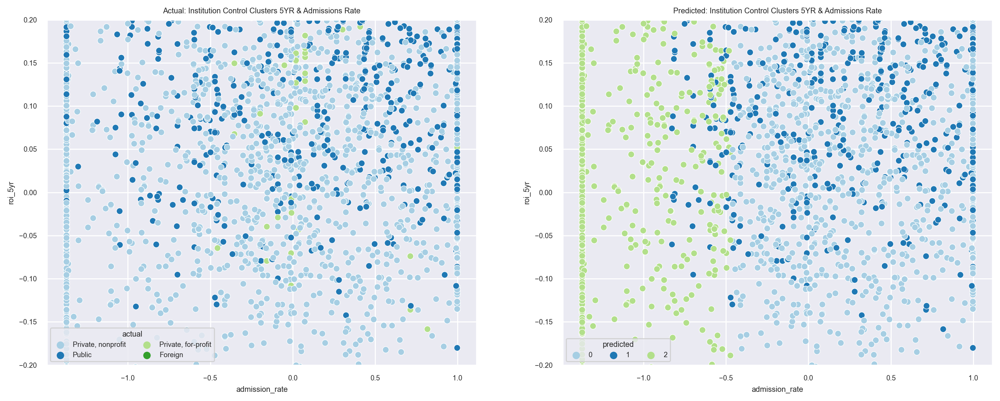

In [38]:
# comparing institution control clusters against actual observations

sns.set(font_scale = 0.6)
plt.subplots(1, 2, figsize = (16, 6), sharex = False, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "admission_rate",
        y = "roi_5yr",
        data = train_imputed.sample(5000, random_state = 123), 
        hue = "institution_control",
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c']
)

plt.title("Actual: Institution Control Clusters 5YR & Admissions Rate")
plt.legend(loc = 'lower left', ncol = 2, title = "actual")
plt.ylim(-.2, .2)

plt.subplot(122)
sns.scatterplot(
        x = "admission_rate",
        y = "roi_5yr",
        data = train_scaled.sample(5000, random_state = 123), 
        hue = "control_clusters_5yr",
        palette = ['#a6cee3','#1f78b4','#b2df8a']
)

plt.title("Predicted: Institution Control Clusters 5YR & Admissions Rate")
plt.legend(loc = 'lower left', ncol = 3, title = "predicted")
plt.ylim(-.2, .2)
plt.show()

--------------------------------------------------
## Cluster 3: University by US Region

In [39]:
# setting features to cluster on 

X_region = train_scaled[[
    'full_time_net_tuition_revenue',
    'us_region_east_north_atlantic',	
    'us_region_east_north_central',	
    'us_region_east_south_atlantic',	
    'us_region_east_south_central',	
    'us_region_midwest_north_central',	
    'us_region_midwest_south_central',	
    'us_region_us_foreign',
    'us_region_west_mountain',
    'us_region_west_pacific'
    ]]

# validate df
X_val = validate_scaled[[
    'full_time_net_tuition_revenue',
    'us_region_east_north_atlantic',	
    'us_region_east_north_central',	
    'us_region_east_south_atlantic',	
    'us_region_east_south_central',	
    'us_region_midwest_north_central',	
    'us_region_midwest_south_central',	
    'us_region_us_foreign',
    'us_region_west_mountain',
    'us_region_west_pacific'
    ]]

# test df
X_test = test_scaled[[
    'full_time_net_tuition_revenue',
    'us_region_east_north_atlantic',	
    'us_region_east_north_central',	
    'us_region_east_south_atlantic',	
    'us_region_east_south_central',	
    'us_region_midwest_north_central',	
    'us_region_midwest_south_central',	
    'us_region_us_foreign',
    'us_region_west_mountain',
    'us_region_west_pacific'
    ]]

X_region.head()

,full_time_net_tuition_revenue,us_region_east_north_atlantic,us_region_east_north_central,us_region_east_south_atlantic,us_region_east_south_central,us_region_midwest_north_central,us_region_midwest_south_central,us_region_us_foreign,us_region_west_mountain,us_region_west_pacific
25530,-0.446191,False,False,False,True,False,False,False,False,False
53875,0.046191,False,False,True,False,False,False,False,False,False
42932,-0.416483,False,False,False,False,False,True,False,False,False
45495,-0.205367,False,True,False,False,False,False,False,False,False
25003,0.502156,True,False,False,False,False,False,False,False,False


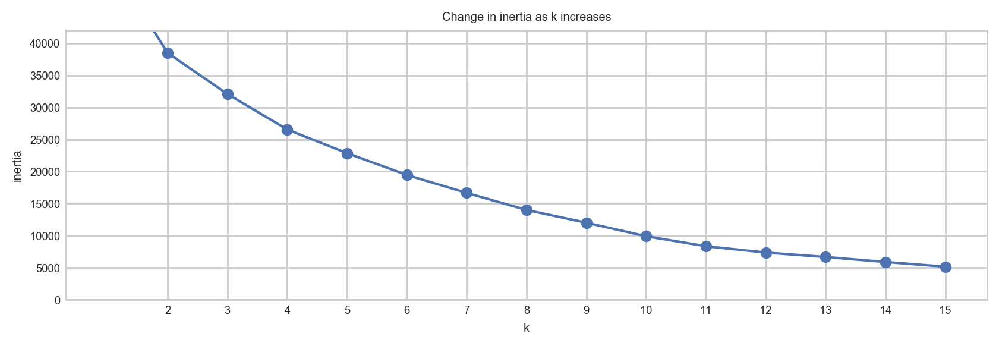

In [40]:
# KMeans Elbow-method

with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize = (10, 3))
    pd.Series({k: KMeans(k, random_state = 123).fit(X_region).inertia_ for k in range(1, 16)}).plot(marker = 'o')
    plt.xticks(range(2, 16))
    
    plt.ylim(0, 42000)
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

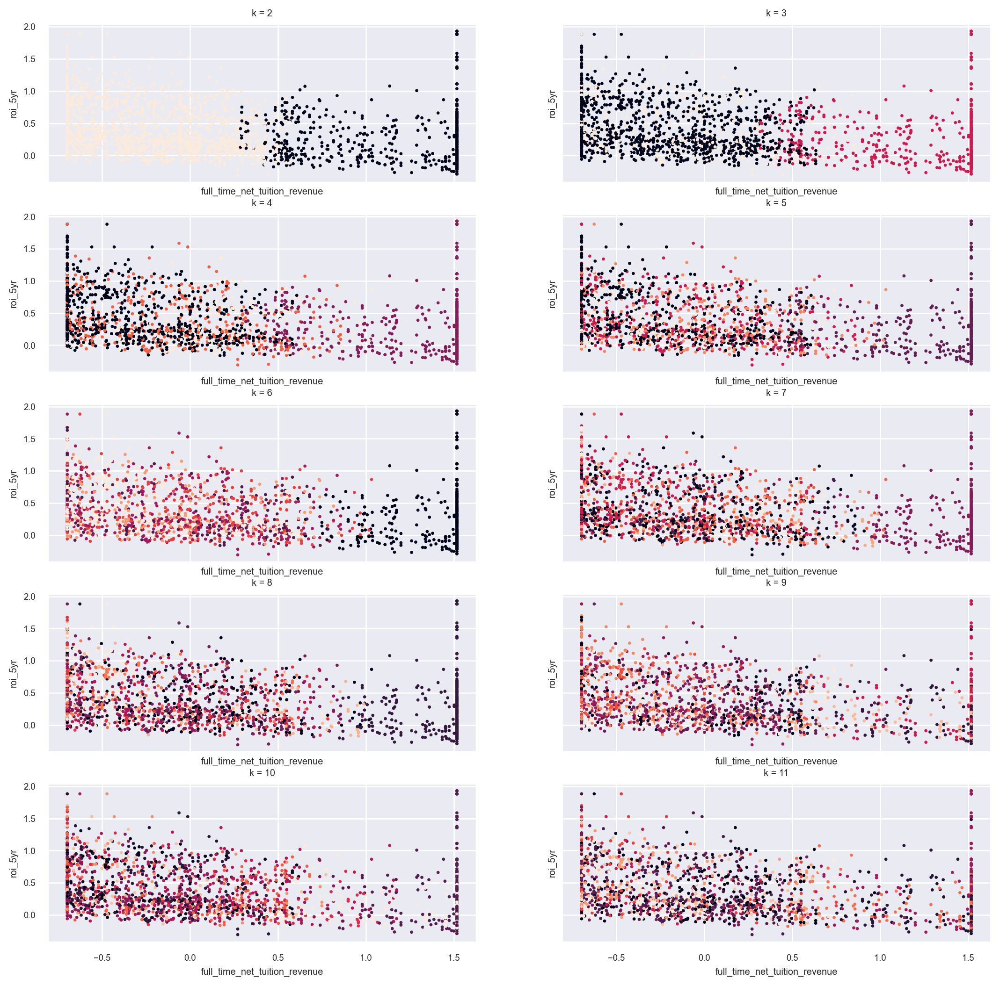

In [41]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(5, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 16)):
    
    X3 = X_region.sample(2000, random_state = 123)

    # creating and fitting KMeans
    clusters = KMeans(k, random_state = 123).fit(X3).predict(X3)

    X3["roi_5yr"] = train_scaled["roi_5yr"]

    ax.scatter(
        X3["full_time_net_tuition_revenue"],
        X3["roi_5yr"],
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'full_time_net_tuition_revenue', ylabel = 'roi_5yr')

In [42]:
# fitting of KMeans cluster to n_cluster 9

kmeans = KMeans(n_clusters = 9, random_state = 123)
kmeans.fit(X_region)

train_clusters = kmeans.predict(X_region)

In [43]:
# creating cluster for ea. dataset 

train_region_clusters_5yr = kmeans.predict(X_region)
val_region_clusters_5yr = kmeans.predict(X_val)
test_region_clusters_5yr = kmeans.predict(X_test)

# viewing cluster samples
pd.DataFrame(train_region_clusters_5yr).rename(columns = {0: "Cluster Sample"}).sample(10, random_state = 123)

,Cluster Sample
21417,8
28667,7
7477,5
24935,5
24966,3
7142,1
30603,1
7930,1
31203,5
1107,5


In [44]:
# adding clusters back to original datasets

train_scaled["region_clusters_5yr"] = train_region_clusters_5yr
validate_scaled["region_clusters_5yr"] = val_region_clusters_5yr
test_scaled["region_clusters_5yr"] = test_region_clusters_5yr

train_scaled.head()

,unit_id_institution,college_name,state_post_code,zip_code,city,region_ipeds,title_IV_eligibility,pred_degree,pred_degree_0and4,degree_name,...,admission_rate_binned_competitive,admission_rate_binned_average_acceptance,admission_rate_binned_above_average_acceptance,SAT_binned_average_sat,SAT_binned_above_average_sat,SAT_binned_competitive_sat,SAT_binned_very_competitive_sat,admission_clusters_5yr,control_clusters_5yr,region_clusters_5yr
25530,0.443437,University of Memphis,TN,38152,Memphis,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,True,False,True,False,False,3,1,6
53875,0.402047,Limestone University,SC,29340-3799,Gaffney,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,True,False,False,False,1,2,1
42932,0.563267,Texas State University,TX,78666,San Marcos,0.50,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,False,True,False,False,3,1,4
45495,-0.732042,Judson University,IL,60123-1498,Elgin,-0.25,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,True,False,False,False,0,0,3
25003,0.078220,Yeshiva University,NY,10033-3299,New York,-0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,False,False,True,4,0,5


In [45]:
# printing average admissions rate by control cluster

unique_clusters = sorted(train_scaled["region_clusters_5yr"].unique().tolist())

container = []

for cluster in unique_clusters:
    
    metric = {
    'region cluster': cluster,
    'full-time tuition revenue': round(train_scaled[train_scaled["region_clusters_5yr"] == cluster]["full_time_net_tuition_revenue"].mean(), 3),
    'min 5YR ROI': round(train_scaled[train_scaled["region_clusters_5yr"] == cluster]["roi_5yr"].min(), 3),
    'max 5YR ROI': round(train_scaled[train_scaled["region_clusters_5yr"] == cluster]["roi_5yr"].max(), 3),
    'range of 5YR ROI': round((train_scaled[train_scaled["region_clusters_5yr"] == cluster]["roi_5yr"].max() - train_scaled[train_scaled["region_clusters_5yr"] == cluster]["roi_5yr"].min()), 2),
    'average 5YR ROI': round(train_scaled[train_scaled["region_clusters_5yr"] == cluster]["roi_5yr"].mean(), 3)
    }

    container.append(metric)

cluster_description = pd.DataFrame(container).sort_values(by = "average 5YR ROI", ascending = False).reset_index(drop = True)
cluster_description

,region cluster,full-time tuition revenue,min 5YR ROI,max 5YR ROI,range of 5YR ROI,average 5YR ROI
0,8,-0.336,-0.169,1.930,2.10,0.544
1,4,-0.249,-0.200,2.103,2.30,0.457
2,2,-0.022,-0.279,1.930,2.21,0.417
3,0,1.386,-0.385,2.103,2.49,0.391
4,6,-0.182,-0.284,1.883,2.17,0.379
5,3,0.020,-0.280,1.883,2.16,0.375
6,1,-0.096,-0.322,1.930,2.25,0.369
7,5,-0.055,-0.382,2.103,2.49,0.368
8,7,-0.127,-0.215,1.969,2.18,0.365


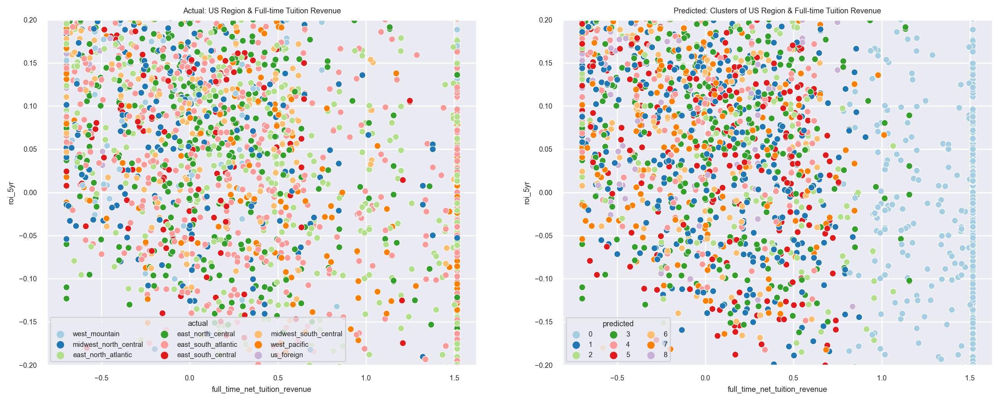

In [46]:
# comparing US region clusters against actual observations

sns.set(font_scale = 0.6)
plt.subplots(1, 2, figsize = (16, 6), sharex = False, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "full_time_net_tuition_revenue",
        y = "roi_5yr",
        data = train_imputed.sample(5000, random_state = 123), 
        hue = "us_region",
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6']
)

plt.title("Actual: US Region & Full-time Tuition Revenue")
plt.legend(loc = 'lower left', ncol = 3, title = "actual")
plt.ylim(-.2, .2)

plt.subplot(122)
sns.scatterplot(
        x = "full_time_net_tuition_revenue",
        y = "roi_5yr",
        data = train_scaled.sample(5000, random_state = 123), 
        hue = "region_clusters_5yr",
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6']
)

plt.title("Predicted: Clusters of US Region & Full-time Tuition Revenue")
plt.legend(loc = 'lower left', ncol = 3, title = "predicted")
plt.ylim(-.2, .2)
plt.show()

----
## Cluster 4: Share of First-time, Full-time Students

In [47]:
# setting features to cluster on 

X_full_time = train_scaled[[
    'avg_faculty_salary',
    'share_entering_ft_binned_below_average',
    'share_entering_ft_binned_average',
    'share_entering_ft_binned_above_average',
    'share_entering_ft_binned_highest_average',
    ]]

# validate df
X_val = validate_scaled[[
    'avg_faculty_salary',
    'share_entering_ft_binned_below_average',
    'share_entering_ft_binned_average',
    'share_entering_ft_binned_above_average',
    'share_entering_ft_binned_highest_average'
    ]]

# test df
X_test = test_scaled[[
    'avg_faculty_salary',
    'share_entering_ft_binned_below_average',
    'share_entering_ft_binned_average',
    'share_entering_ft_binned_above_average',
    'share_entering_ft_binned_highest_average'
    ]]

X_full_time.head()

,avg_faculty_salary,share_entering_ft_binned_below_average,share_entering_ft_binned_average,share_entering_ft_binned_above_average,share_entering_ft_binned_highest_average
25530,0.212325,False,True,False,False
53875,-0.719918,True,False,False,False
42932,-0.060456,True,False,False,False
45495,-0.523949,True,False,False,False
25003,1.159755,False,False,False,True


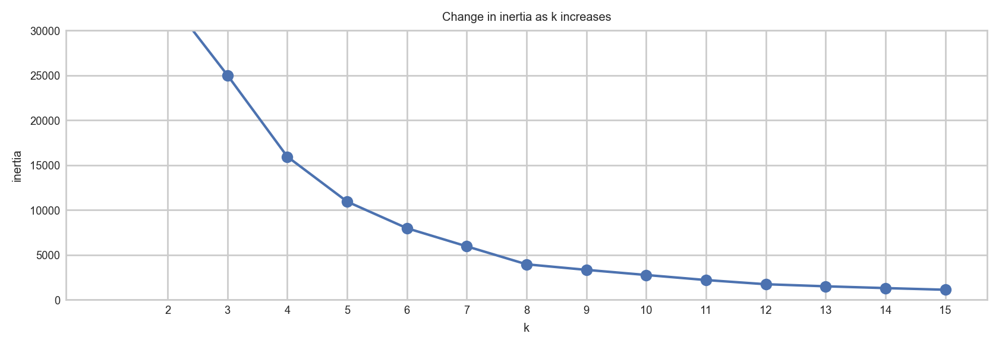

In [48]:
# KMeans Elbow-method

with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize = (10, 3))
    pd.Series({k: KMeans(k).fit(X_full_time).inertia_ for k in range(1, 16)}).plot(marker = 'o')
    plt.xticks(range(2, 16))
    
    plt.ylim(0, 30000)
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

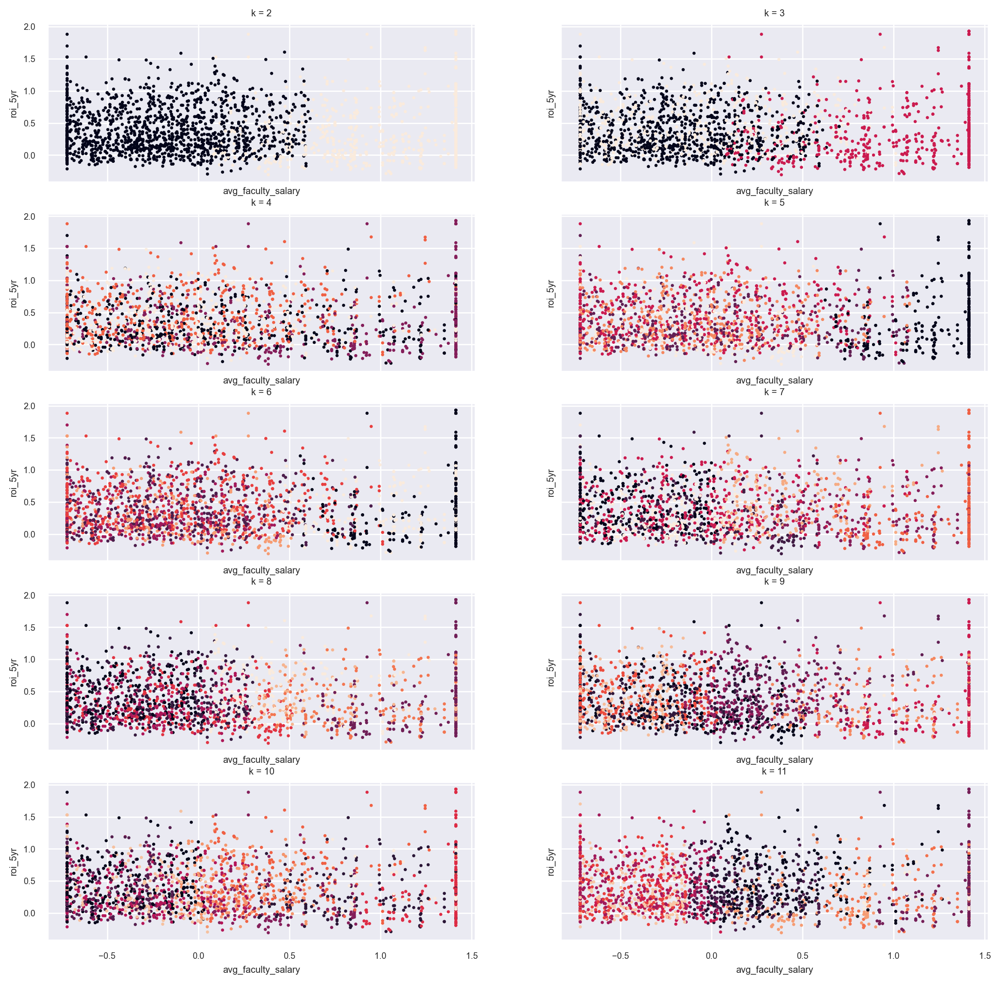

In [49]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(5, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 16)):
    
    X4 = X_full_time.sample(2000, random_state = 123)

    # creating and fitting KMeans
    clusters = KMeans(k).fit(X4).predict(X4)

    X4["roi_5yr"] = train_scaled["roi_5yr"]

    ax.scatter(
        X4["avg_faculty_salary"],
        X4["roi_5yr"],
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'avg_faculty_salary', ylabel = 'roi_5yr')

In [50]:
# initial fitting of KMeans cluster

kmeans = KMeans(n_clusters = 6, random_state = 123)
kmeans.fit(X_full_time)

train_clusters = kmeans.predict(X_full_time)

In [51]:
# creating cluster for ea. dataset 

train_ft_clusters_5yr = kmeans.predict(X_full_time)
val_ft_clusters_5yr = kmeans.predict(X_val)
test_ft_clusters_5yr = kmeans.predict(X_test)

# viewing cluster samples
pd.DataFrame(train_ft_clusters_5yr).rename(columns = {0: "Cluster Sample"}).sample(10, random_state = 123)

,Cluster Sample
21417,1
28667,4
7477,3
24935,0
24966,1
7142,3
30603,2
7930,0
31203,3
1107,0


In [52]:
# adding clusters back to original datasets

train_scaled["ft_clusters_5yr"] = train_ft_clusters_5yr
validate_scaled["ft_clusters_5yr"] = val_ft_clusters_5yr
test_scaled["ft_clusters_5yr"] = test_ft_clusters_5yr

train_scaled.head()

,unit_id_institution,college_name,state_post_code,zip_code,city,region_ipeds,title_IV_eligibility,pred_degree,pred_degree_0and4,degree_name,...,admission_rate_binned_average_acceptance,admission_rate_binned_above_average_acceptance,SAT_binned_average_sat,SAT_binned_above_average_sat,SAT_binned_competitive_sat,SAT_binned_very_competitive_sat,admission_clusters_5yr,control_clusters_5yr,region_clusters_5yr,ft_clusters_5yr
25530,0.443437,University of Memphis,TN,38152,Memphis,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,True,False,False,3,1,6,1
53875,0.402047,Limestone University,SC,29340-3799,Gaffney,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,True,False,False,False,1,2,1,0
42932,0.563267,Texas State University,TX,78666,San Marcos,0.50,0.0,0.0,0.0,Bachelors Degree,...,True,False,False,True,False,False,3,1,4,0
45495,-0.732042,Judson University,IL,60123-1498,Elgin,-0.25,0.0,0.0,0.0,Bachelors Degree,...,True,False,True,False,False,False,0,0,3,0
25003,0.078220,Yeshiva University,NY,10033-3299,New York,-0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,False,True,4,0,5,2


In [53]:
# printing average admissions rate by control cluster

unique_clusters = sorted(train_scaled["ft_clusters_5yr"].unique().tolist())

container = []

for cluster in unique_clusters:
    
    metric = {
    'full-time cluster': cluster,
    'avg faculty salary': round(train_scaled[train_scaled["ft_clusters_5yr"] == cluster]["avg_faculty_salary"].mean(), 3),
    'min 5YR ROI': round(train_scaled[train_scaled["ft_clusters_5yr"] == cluster]["roi_5yr"].min(), 3),
    'max 5YR ROI': round(train_scaled[train_scaled["ft_clusters_5yr"] == cluster]["roi_5yr"].max(), 3),
    'range of 5YR ROI': round((train_scaled[train_scaled["ft_clusters_5yr"] == cluster]["roi_5yr"].max() - train_scaled[train_scaled["ft_clusters_5yr"] == cluster]["roi_5yr"].min()), 2),
    'average 5YR ROI': round(train_scaled[train_scaled["ft_clusters_5yr"] == cluster]["roi_5yr"].mean(), 3)
    }

    container.append(metric)

cluster_description = pd.DataFrame(container).sort_values(by = "average 5YR ROI", ascending = False).reset_index(drop = True)
cluster_description

,full-time cluster,avg faculty salary,min 5YR ROI,max 5YR ROI,range of 5YR ROI,average 5YR ROI
0,2,1.274,-0.382,2.103,2.49,0.556
1,0,-0.113,-0.322,1.969,2.29,0.457
2,1,-0.090,-0.385,1.696,2.08,0.381
3,3,-0.306,-0.319,1.700,2.02,0.319
4,5,0.877,-0.364,1.528,1.89,0.300
5,4,-0.099,-0.363,2.103,2.47,0.299


----
## Cluster 5: College Majors

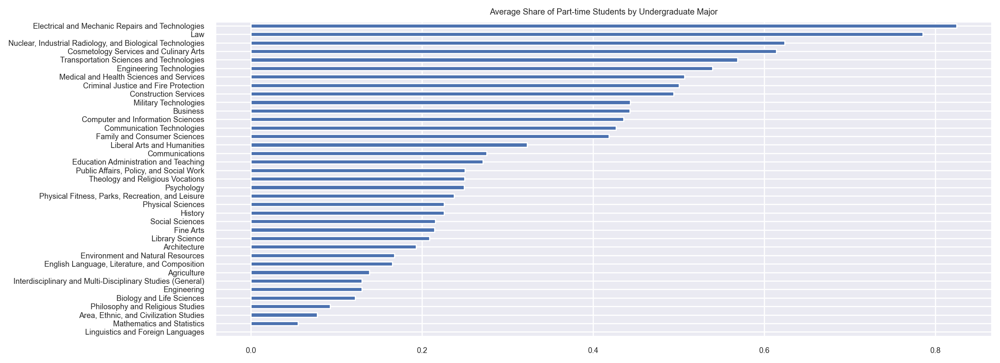

In [54]:
# viewing the average share of part-time students by major

plt.figure(figsize = (12,5))
sns.set(font_scale = 0.6)

train_imputed.groupby(["major_category"])["share_of_part_time"].mean().sort_values().plot(kind = "barh")

plt.ylabel(None)
plt.title("Average Share of Part-time Students by Undergraduate Major")
plt.show()

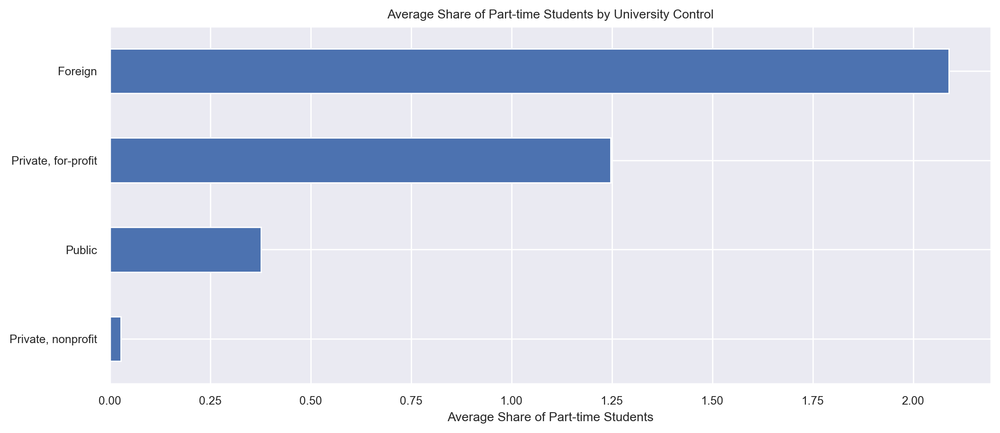

In [55]:
# viewing average share of part-time students by university control

plt.figure(figsize = (12,5))
sns.set(font_scale = 0.8)

train.groupby(["institution_control"])["share_of_part_time"].mean().sort_values().plot(kind = "barh")

plt.ylabel(None)
plt.xlabel("Average Share of Part-time Students")
plt.title("Average Share of Part-time Students by University Control")
plt.show()

In [56]:
# setting features to cluster on 

X_majors = train_scaled[[
    'share_of_part_time',
    'major_category_Agriculture',
    'major_category_Architecture',
    'major_category_Area, Ethnic, and Civilization Studies',
    'major_category_Biology and Life Sciences',
    'major_category_Business',
    'major_category_Communication Technologies',
    'major_category_Communications',
    'major_category_Computer and Information Sciences',
    'major_category_Construction Services',
    'major_category_Cosmetology Services and Culinary Arts',
    'major_category_Criminal Justice and Fire Protection',
    'major_category_Education Administration and Teaching',
    'major_category_Electrical and Mechanic Repairs and Technologies',
    'major_category_Engineering',
    'major_category_Engineering Technologies',
    'major_category_English Language, Literature, and Composition',
    'major_category_Environment and Natural Resources',
    'major_category_Family and Consumer Sciences',
    'major_category_Fine Arts',
    'major_category_History',
    'major_category_Interdisciplinary and Multi-Disciplinary Studies (General)',
    'major_category_Law',
    'major_category_Liberal Arts and Humanities',
    'major_category_Library Science',
    'major_category_Linguistics and Foreign Languages',
    'major_category_Mathematics and Statistics',
    'major_category_Medical and Health Sciences and Services',
    'major_category_Military Technologies',
    'major_category_Nuclear, Industrial Radiology, and Biological Technologies',
    'major_category_Philosophy and Religious Studies',
    'major_category_Physical Fitness, Parks, Recreation, and Leisure',
    'major_category_Physical Sciences',
    'major_category_Psychology',
    'major_category_Public Affairs, Policy, and Social Work',
    'major_category_Social Sciences',
    'major_category_Theology and Religious Vocations',
    'major_category_Transportation Sciences and Technologies'
    ]]

# validate df
X_val = validate_scaled[[
    'share_of_part_time',
    'major_category_Agriculture',
    'major_category_Architecture',
    'major_category_Area, Ethnic, and Civilization Studies',
    'major_category_Biology and Life Sciences',
    'major_category_Business',
    'major_category_Communication Technologies',
    'major_category_Communications',
    'major_category_Computer and Information Sciences',
    'major_category_Construction Services',
    'major_category_Cosmetology Services and Culinary Arts',
    'major_category_Criminal Justice and Fire Protection',
    'major_category_Education Administration and Teaching',
    'major_category_Electrical and Mechanic Repairs and Technologies',
    'major_category_Engineering',
    'major_category_Engineering Technologies',
    'major_category_English Language, Literature, and Composition',
    'major_category_Environment and Natural Resources',
    'major_category_Family and Consumer Sciences',
    'major_category_Fine Arts',
    'major_category_History',
    'major_category_Interdisciplinary and Multi-Disciplinary Studies (General)',
    'major_category_Law',
    'major_category_Liberal Arts and Humanities',
    'major_category_Library Science',
    'major_category_Linguistics and Foreign Languages',
    'major_category_Mathematics and Statistics',
    'major_category_Medical and Health Sciences and Services',
    'major_category_Military Technologies',
    'major_category_Nuclear, Industrial Radiology, and Biological Technologies',
    'major_category_Philosophy and Religious Studies',
    'major_category_Physical Fitness, Parks, Recreation, and Leisure',
    'major_category_Physical Sciences',
    'major_category_Psychology',
    'major_category_Public Affairs, Policy, and Social Work',
    'major_category_Social Sciences',
    'major_category_Theology and Religious Vocations',
    'major_category_Transportation Sciences and Technologies'
    ]]

# test df
X_test = test_scaled[[
    'share_of_part_time',
    'major_category_Agriculture',
    'major_category_Architecture',
    'major_category_Area, Ethnic, and Civilization Studies',
    'major_category_Biology and Life Sciences',
    'major_category_Business',
    'major_category_Communication Technologies',
    'major_category_Communications',
    'major_category_Computer and Information Sciences',
    'major_category_Construction Services',
    'major_category_Cosmetology Services and Culinary Arts',
    'major_category_Criminal Justice and Fire Protection',
    'major_category_Education Administration and Teaching',
    'major_category_Electrical and Mechanic Repairs and Technologies',
    'major_category_Engineering',
    'major_category_Engineering Technologies',
    'major_category_English Language, Literature, and Composition',
    'major_category_Environment and Natural Resources',
    'major_category_Family and Consumer Sciences',
    'major_category_Fine Arts',
    'major_category_History',
    'major_category_Interdisciplinary and Multi-Disciplinary Studies (General)',
    'major_category_Law',
    'major_category_Liberal Arts and Humanities',
    'major_category_Library Science',
    'major_category_Linguistics and Foreign Languages',
    'major_category_Mathematics and Statistics',
    'major_category_Medical and Health Sciences and Services',
    'major_category_Military Technologies',
    'major_category_Nuclear, Industrial Radiology, and Biological Technologies',
    'major_category_Philosophy and Religious Studies',
    'major_category_Physical Fitness, Parks, Recreation, and Leisure',
    'major_category_Physical Sciences',
    'major_category_Psychology',
    'major_category_Public Affairs, Policy, and Social Work',
    'major_category_Social Sciences',
    'major_category_Theology and Religious Vocations',
    'major_category_Transportation Sciences and Technologies'
    ]]

X_majors.head()

,share_of_part_time,major_category_Agriculture,major_category_Architecture,"major_category_Area, Ethnic, and Civilization Studies",major_category_Biology and Life Sciences,major_category_Business,major_category_Communication Technologies,major_category_Communications,major_category_Computer and Information Sciences,major_category_Construction Services,...,major_category_Military Technologies,"major_category_Nuclear, Industrial Radiology, and Biological Technologies",major_category_Philosophy and Religious Studies,"major_category_Physical Fitness, Parks, Recreation, and Leisure",major_category_Physical Sciences,major_category_Psychology,"major_category_Public Affairs, Policy, and Social Work",major_category_Social Sciences,major_category_Theology and Religious Vocations,major_category_Transportation Sciences and Technologies
25530,0.820877,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
53875,0.723286,False,False,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,False,False,False
42932,0.526251,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
45495,1.419395,False,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
25003,-0.470661,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


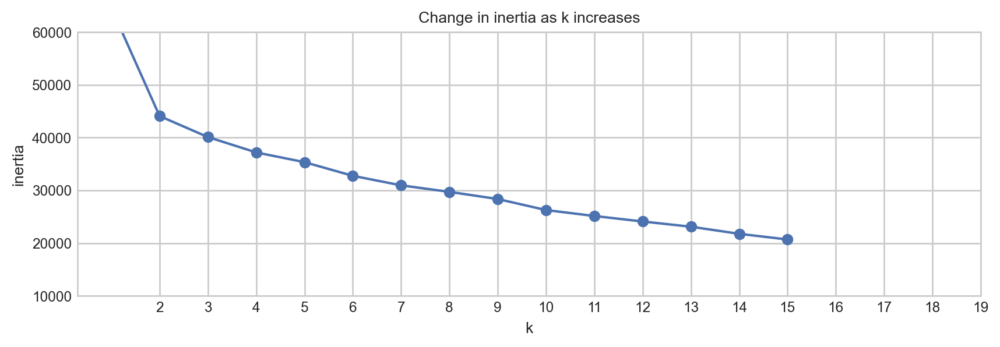

In [57]:
# KMeans Elbow-method

with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize = (10, 3))
    pd.Series({k: KMeans(k).fit(X_majors).inertia_ for k in range(1, 16)}).plot(marker = 'o')
    plt.xticks(range(2, 20))
    
    plt.ylim(10000, 60000)
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

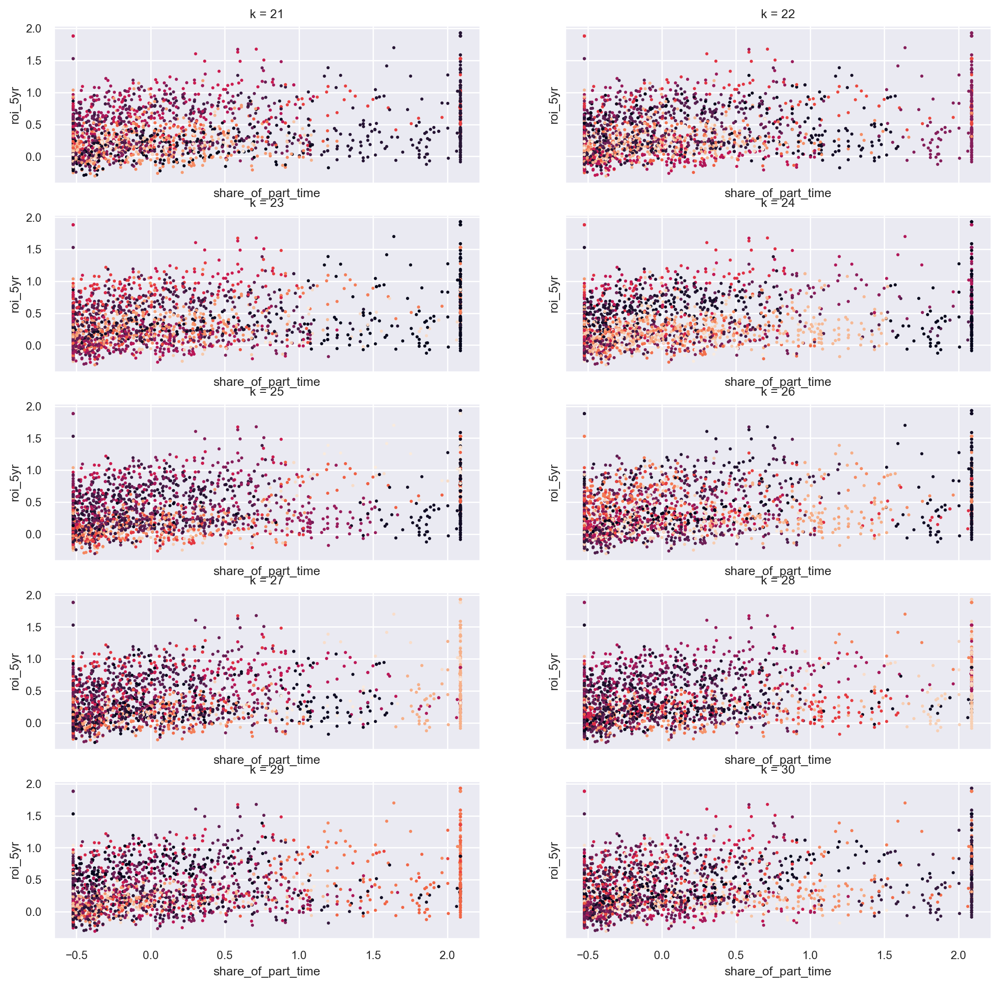

In [58]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(5, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(21, 31)):
    
    X5 = X_majors.sample(2000, random_state = 123)

    # creating and fitting KMeans
    clusters = KMeans(k).fit(X5).predict(X5)

    X5["roi_5yr"] = train_scaled["roi_5yr"]

    ax.scatter(
        X5["share_of_part_time"],
        X5["roi_5yr"],
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'share_of_part_time', ylabel = 'roi_5yr')

In [59]:
# fitting of KMeans cluster

kmeans = KMeans(n_clusters = 30)
kmeans.fit(X_majors)

train_clusters = kmeans.predict(X_majors)

In [60]:
# creating cluster for ea. dataset 

train_majors_clusters_5yr = kmeans.predict(X_majors)
val_majors_clusters_5yr = kmeans.predict(X_val)
test_majors_clusters_5yr = kmeans.predict(X_test)

# viewing cluster samples
pd.DataFrame(train_majors_clusters_5yr).rename(columns = {0: "Cluster Sample"}).sample(10, random_state = 123)

,Cluster Sample
21417,11
28667,3
7477,4
24935,27
24966,8
7142,3
30603,18
7930,25
31203,9
1107,5


In [61]:
# adding clusters back to original datasets

train_scaled["major_clusters_5yr"] = train_majors_clusters_5yr
validate_scaled["major_clusters_5yr"] = val_majors_clusters_5yr
test_scaled["major_clusters_5yr"] = test_majors_clusters_5yr

train_scaled.head()

,unit_id_institution,college_name,state_post_code,zip_code,city,region_ipeds,title_IV_eligibility,pred_degree,pred_degree_0and4,degree_name,...,admission_rate_binned_above_average_acceptance,SAT_binned_average_sat,SAT_binned_above_average_sat,SAT_binned_competitive_sat,SAT_binned_very_competitive_sat,admission_clusters_5yr,control_clusters_5yr,region_clusters_5yr,ft_clusters_5yr,major_clusters_5yr
25530,0.443437,University of Memphis,TN,38152,Memphis,0.25,0.0,0.0,0.0,Bachelors Degree,...,True,False,True,False,False,3,1,6,1,8
53875,0.402047,Limestone University,SC,29340-3799,Gaffney,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,False,False,1,2,1,0,19
42932,0.563267,Texas State University,TX,78666,San Marcos,0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,True,False,False,3,1,4,0,3
45495,-0.732042,Judson University,IL,60123-1498,Elgin,-0.25,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,False,False,0,0,3,0,25
25003,0.078220,Yeshiva University,NY,10033-3299,New York,-0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,True,4,0,5,2,8


In [62]:
# printing average admissions rate by control cluster

unique_clusters = sorted(train_scaled["major_clusters_5yr"].unique().tolist())

container = []

for cluster in unique_clusters:
    
    metric = {
    'major cluster': cluster,
    'share of part-time students': round(train_scaled[train_scaled["major_clusters_5yr"] == cluster]["share_of_part_time"].mean(), 3),
    'min 5YR ROI': round(train_scaled[train_scaled["major_clusters_5yr"] == cluster]["roi_5yr"].min(), 3),
    'max 5YR ROI': round(train_scaled[train_scaled["major_clusters_5yr"] == cluster]["roi_5yr"].max(), 3),
    'range of 5YR ROI': round((train_scaled[train_scaled["major_clusters_5yr"] == cluster]["roi_5yr"].max() - train_scaled[train_scaled["major_clusters_5yr"] == cluster]["roi_5yr"].min()), 2),
    'average 5YR ROI': round(train_scaled[train_scaled["major_clusters_5yr"] == cluster]["roi_5yr"].mean(), 3)
    }

    container.append(metric)

cluster_description = pd.DataFrame(container).sort_values(by = "average 5YR ROI", ascending = False).reset_index(drop = True)
cluster_description

,major cluster,share of part-time students,min 5YR ROI,max 5YR ROI,range of 5YR ROI,average 5YR ROI
0,25,1.961,0.244,1.604,1.36,1.102
1,14,-0.085,0.405,1.930,1.52,0.981
2,10,-0.066,0.287,1.883,1.60,0.960
3,13,0.621,0.129,1.529,1.40,0.803
4,11,2.041,-0.322,2.103,2.43,0.732
5,2,-0.243,0.084,1.529,1.44,0.669
6,7,-0.137,0.191,1.484,1.29,0.646
7,6,-0.079,0.113,1.358,1.24,0.580
8,27,1.126,-0.280,1.883,2.16,0.515
9,1,1.724,-0.082,0.866,0.95,0.469


----
## Cluster 6: SAT Score

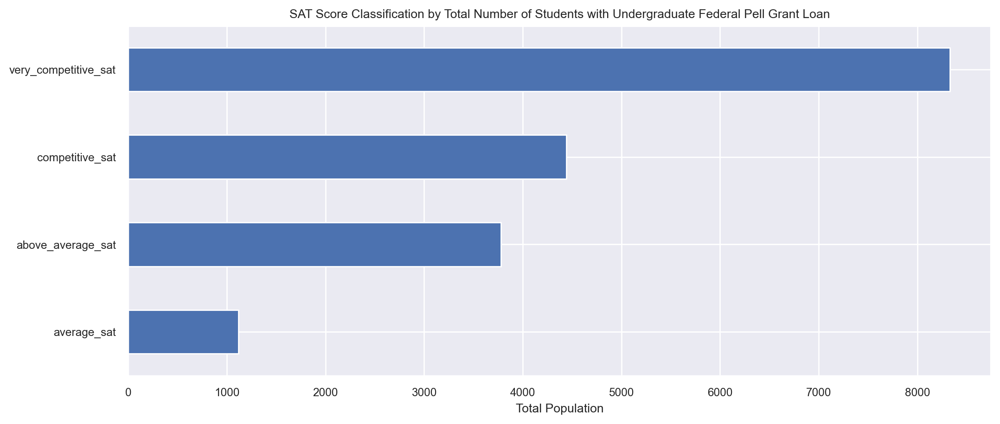

In [63]:
# viewing SAT Score bins against Undergraduate Pell Grant Federal Loans

plt.figure(figsize = (12,5))
sns.set(font_scale = 0.8)

train_imputed.groupby(["SAT_binned"])["undergraduate_number_pell_grant_federal_loan"].sum().plot(kind = "barh")

plt.title("SAT Score Classification by Total Number of Students with Undergraduate Federal Pell Grant Loan")
plt.ylabel(None)
plt.xlabel("Total Population")
plt.show()

In [64]:
# setting features to cluster on 

X_sat = train_scaled[[
    'undergraduate_number_pell_grant_federal_loan',
    'SAT_binned_average_sat',
    'SAT_binned_above_average_sat',	
    'SAT_binned_competitive_sat',	
    'SAT_binned_very_competitive_sat'
    ]]

# validate df
X_val = validate_scaled[[
    'undergraduate_number_pell_grant_federal_loan',
    'SAT_binned_average_sat',
    'SAT_binned_above_average_sat',	
    'SAT_binned_competitive_sat',	
    'SAT_binned_very_competitive_sat'    
    ]]

# test df
X_test = test_scaled[[
    'undergraduate_number_pell_grant_federal_loan',
    'SAT_binned_average_sat',
    'SAT_binned_above_average_sat',	
    'SAT_binned_competitive_sat',	
    'SAT_binned_very_competitive_sat'    
    ]]

X_sat.head()

,undergraduate_number_pell_grant_federal_loan,SAT_binned_average_sat,SAT_binned_above_average_sat,SAT_binned_competitive_sat,SAT_binned_very_competitive_sat
25530,1.270727,False,True,False,False
53875,-0.109832,True,False,False,False
42932,2.369975,False,True,False,False
45495,-0.250487,True,False,False,False
25003,-0.101755,False,False,False,True


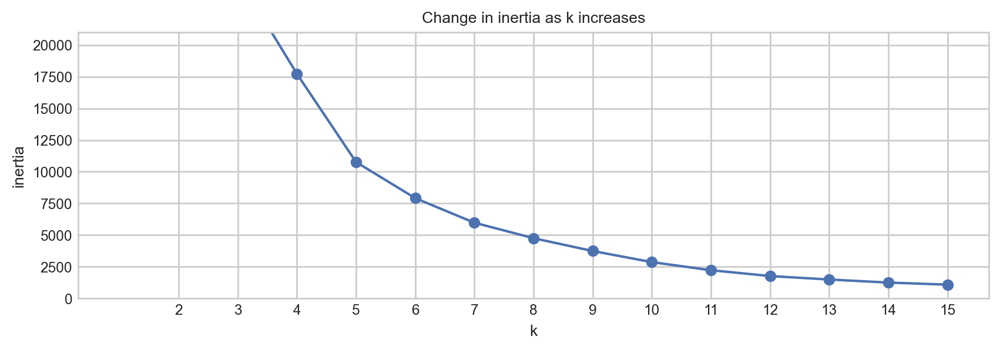

In [65]:
# KMeans Elbow-method

with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize = (10, 3))
    pd.Series({k: KMeans(k).fit(X_sat).inertia_ for k in range(1, 16)}).plot(marker = 'o')
    plt.xticks(range(2, 16))
    
    plt.ylim(0, 21000)
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

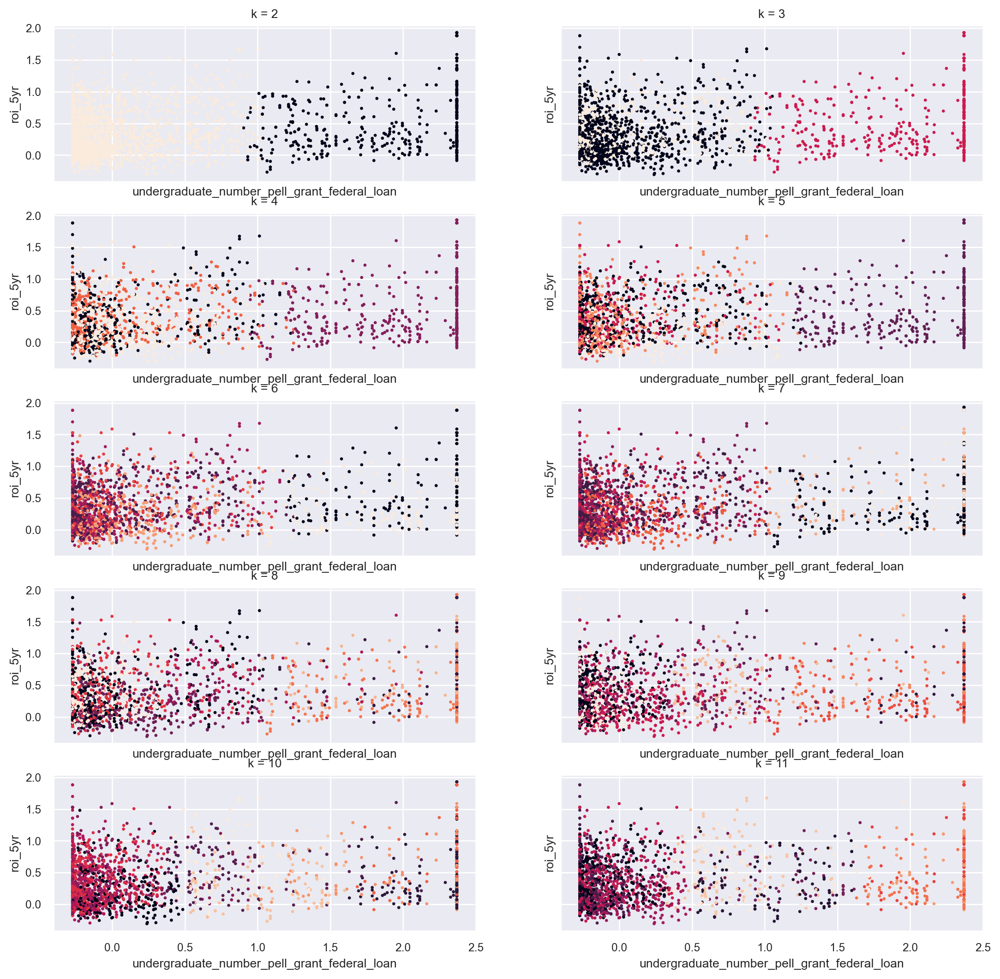

In [66]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(5, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 16)):
    
    X6 = X_sat.sample(2000, random_state = 123)

    # creating and fitting KMeans
    clusters = KMeans(k).fit(X6).predict(X6)

    X6["roi_5yr"] = train_scaled["roi_5yr"]

    ax.scatter(
        X6["undergraduate_number_pell_grant_federal_loan"],
        X6["roi_5yr"],
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'undergraduate_number_pell_grant_federal_loan', ylabel = 'roi_5yr')

In [67]:
# fitting of KMeans cluster

kmeans = KMeans(n_clusters = 4)
kmeans.fit(X_sat)

train_clusters = kmeans.predict(X_sat)

In [68]:
# creating cluster for ea. dataset

train_sat_clusters_5yr = kmeans.predict(X_sat)
val_sat_clusters_5yr = kmeans.predict(X_val)
test_sat_clusters_5yr = kmeans.predict(X_test)

# viewing cluster samples
pd.DataFrame(train_sat_clusters_5yr).rename(columns = {0: "Cluster Sample"}).sample(10, random_state = 123)

,Cluster Sample
21417,1
28667,3
7477,1
24935,2
24966,2
7142,2
30603,1
7930,3
31203,3
1107,2


In [69]:
# adding clusters back to original datasets

train_scaled["sat_clusters_5yr"] = train_sat_clusters_5yr
validate_scaled["sat_clusters_5yr"] = val_sat_clusters_5yr
test_scaled["sat_clusters_5yr"] = test_sat_clusters_5yr

train_scaled.head()

,unit_id_institution,college_name,state_post_code,zip_code,city,region_ipeds,title_IV_eligibility,pred_degree,pred_degree_0and4,degree_name,...,SAT_binned_average_sat,SAT_binned_above_average_sat,SAT_binned_competitive_sat,SAT_binned_very_competitive_sat,admission_clusters_5yr,control_clusters_5yr,region_clusters_5yr,ft_clusters_5yr,major_clusters_5yr,sat_clusters_5yr
25530,0.443437,University of Memphis,TN,38152,Memphis,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,False,3,1,6,1,8,0
53875,0.402047,Limestone University,SC,29340-3799,Gaffney,0.25,0.0,0.0,0.0,Bachelors Degree,...,True,False,False,False,1,2,1,0,19,2
42932,0.563267,Texas State University,TX,78666,San Marcos,0.50,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,False,3,1,4,0,3,0
45495,-0.732042,Judson University,IL,60123-1498,Elgin,-0.25,0.0,0.0,0.0,Bachelors Degree,...,True,False,False,False,0,0,3,0,25,2
25003,0.078220,Yeshiva University,NY,10033-3299,New York,-0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,True,4,0,5,2,8,1


In [70]:
# printing undergraduate pell grant loan rate by admitted SAT

unique_clusters = sorted(train_scaled["sat_clusters_5yr"].unique().tolist())

container = []

for cluster in unique_clusters:
    
    metric = {
    'major cluster': cluster,
    'undergrad federal loan': round(train_scaled[train_scaled["sat_clusters_5yr"] == cluster]["undergraduate_number_pell_grant_federal_loan"].mean(), 3),
    'min 5YR ROI': round(train_scaled[train_scaled["sat_clusters_5yr"] == cluster]["roi_5yr"].min(), 3),
    'max 5YR ROI': round(train_scaled[train_scaled["sat_clusters_5yr"] == cluster]["roi_5yr"].max(), 3),
    'range of 5YR ROI': round((train_scaled[train_scaled["sat_clusters_5yr"] == cluster]["roi_5yr"].max() - train_scaled[train_scaled["sat_clusters_5yr"] == cluster]["roi_5yr"].min()), 2),
    'average 5YR ROI': round(train_scaled[train_scaled["sat_clusters_5yr"] == cluster]["roi_5yr"].mean(), 3)
    }

    container.append(metric)

cluster_description = pd.DataFrame(container).sort_values(by = "average 5YR ROI", ascending = False).reset_index(drop = True)
cluster_description

,major cluster,undergrad federal loan,min 5YR ROI,max 5YR ROI,range of 5YR ROI,average 5YR ROI
0,0,1.979,-0.339,2.103,2.44,0.566
1,3,-0.036,-0.385,2.103,2.49,0.394
2,2,0.043,-0.295,1.787,2.08,0.372
3,1,0.064,-0.382,1.969,2.35,0.309


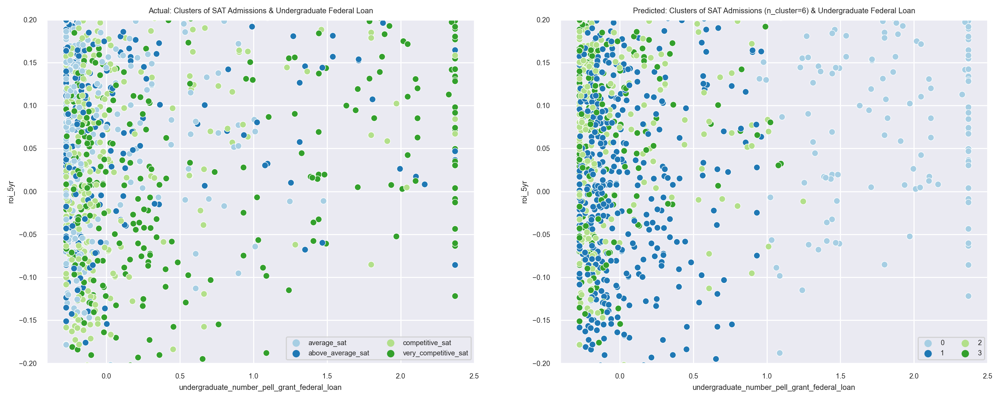

In [71]:
# comparing SAT clusters against actual observations

sns.set(font_scale = 0.6)
plt.subplots(1, 2, figsize = (16, 6), sharex = False, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "undergraduate_number_pell_grant_federal_loan",
        y = "roi_5yr",
        data = train_imputed.sample(2500, random_state = 123), 
        hue = "SAT_binned",
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c']
)

plt.title("Actual: Clusters of SAT Admissions & Undergraduate Federal Loan")
plt.legend(loc = 'lower right', ncol = 2)
plt.ylim(-.2, .2)

plt.subplot(122)
sns.scatterplot(
        x = "undergraduate_number_pell_grant_federal_loan",
        y = "roi_5yr",
        data = train_scaled.sample(2500, random_state = 123), 
        hue = "sat_clusters_5yr",
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c']
)

plt.title("Predicted: Clusters of SAT Admissions (n_cluster=6) & Undergraduate Federal Loan")
plt.legend(loc = 'lower right', ncol = 2)
plt.ylim(-.2, .2)
plt.show()

----
# Modeling


In [72]:
# creating dummy dataframes with generated clusters for modeling

train_model, validate_model, test_model = model.get_cluster_dummy(train_scaled, validate_scaled, test_scaled)
print(f'dataframe shape: {train_model.shape}')
train_model.head()

dataframe shape: (39995, 230)


,unit_id_institution,college_name,state_post_code,zip_code,city,region_ipeds,title_IV_eligibility,pred_degree,pred_degree_0and4,degree_name,...,major_clusters_5yr_24,major_clusters_5yr_25,major_clusters_5yr_26,major_clusters_5yr_27,major_clusters_5yr_28,major_clusters_5yr_29,sat_clusters_5yr_0,sat_clusters_5yr_1,sat_clusters_5yr_2,sat_clusters_5yr_3
25530,0.443437,University of Memphis,TN,38152,Memphis,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,False,False,True,False,False,False
53875,0.402047,Limestone University,SC,29340-3799,Gaffney,0.25,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,False,False,False,False,True,False
42932,0.563267,Texas State University,TX,78666,San Marcos,0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,False,False,True,False,False,False
45495,-0.732042,Judson University,IL,60123-1498,Elgin,-0.25,0.0,0.0,0.0,Bachelors Degree,...,False,True,False,False,False,False,False,False,True,False
25003,0.078220,Yeshiva University,NY,10033-3299,New York,-0.50,0.0,0.0,0.0,Bachelors Degree,...,False,False,False,False,False,False,False,True,False,False


----
### ``Establishing a Model Baseline``

In [73]:
# get 5YR ROI predictive baseline for training and validate datasets

train_model, validate_model = model.establish_baseline(train_model, validate_model)

Train baseline RMSE: 0.41
Validate baseline RMSE: 0.41

train shape: (39995, 230)
validate shape: (17142, 230)


In [74]:
# create copies 
train_model_actual = train_model.copy()
validate_model_actual = validate_model.copy()

### ``RFECV all features: exclusive of target variables``

In [75]:
# training dataset

X_train = train_model[[
    'unit_id_institution',
    # 'college_name',
    # 'state_post_code',
    # 'zip_code',
    # 'city',
    'region_ipeds',
    'title_IV_eligibility',
    'pred_degree',
    'pred_degree_0and4',
    # 'degree_name',
    'degree_code',
    'major_code',
    # 'major_name',
    'branch_number',
    'avg_net_price_public',
    'avg_net_price_private',
    'full_time_net_tuition_revenue',
    'off_campus_cost_of_attendace',
    'on_campus_cost_of_attendace',
    'admission_rate',
    'graduate_number',
    'ACT_score_mid',
    'avg_sat_admitted',
    'required_score',
    'avg_faculty_salary',
    'online_only',
    'comp_rt_ft_150over_expected_time',
    'comp_rt_ft_150over_expected_time_two_races',
    'comp_rt_ft_150over_expected_time_native_american',
    'comp_rt_ft_150over_expected_time_asian',
    'comp_rt_ft_150over_expected_time_black',
    'comp_rt_ft_150over_expected_time_hispanic',
    'comp_rt_ft_150over_expected_time_non_resident',
    'comp_rt_ft_150over_expected_time_unknown_race',
    'comp_rt_ft_150over_expected_time_white',
    'share_entering_students_first_ft',
    'share_of_part_time',
    'first_time_ft_student_retention',
    'first_time_pt_student_retention',
    'enrollment_share_two_races',
    'enrollment_share_native_american',
    'enrollment_share_asian',
    'enrollment_share_black',
    'enrollment_share_hispanic',
    'enrollment_share_pac_islander',
    'enrollment_share_non_resident',
    'enrollment_share_unknown',
    'enrollment_share_white',
    'undergraduate_number_pell_grant_federal_loan',
    'med_debt_pell_students',
    'median_debt_completed',
    # 'median_debt_non_first_generation',
    'median_debt_non_pell',
    'federal_loan_full_time_first_time_undergraduate',
    'pell_grant_full_time_first_time_undergraduate',
    'deg_percent_awarded_agriculture_operations',
    'deg_percent_awarded_natural_resources',
    'deg_percent_awarded_architecture',
    'deg_percent_awarded_area_ethnic_cultural_gender',
    'deg_percent_awarded_communication_journalism',
    'deg_percent_awarded_communication_tech',
    'deg_percent_awarded_computer_science',
    'deg_percent_awarded_personal_culinary_services',
    'deg_percent_awarded_education',
    'deg_percent_awarded_engineering',
    'deg_percent_awarded_engineering_tech',
    'deg_percent_awarded_foreign_language_literatures',
    'deg_percent_awarded_human_science',
    'deg_percent_awarded_legal_profession',
    'deg_percent_awarded_english_lang',
    'deg_percent_awarded_general_studies',
    'deg_percent_awarded_library_sciences',
    'deg_percent_awarded_bio_sciences',
    'deg_percent_awarded_mathematics',
    'deg_percent_awarded_military_tech',
    'deg_percent_awarded_intedisciplinary_studies',
    'deg_percent_awarded_leisure_fitness',
    'deg_percent_awarded_philosophy',
    'deg_percent_awarded_theology',
    'deg_percent_awarded_physical_sciences',
    'deg_percent_awarded_science_tech',
    'deg_percent_awarded_psychology',
    'deg_percent_awarded_homeland_security',
    'deg_percent_awarded_public_admin',
    'deg_percent_awarded_social_sciences',
    'deg_percent_awarded_construction_trades',
    'deg_percent_awarded_mechanic_repair',
    'deg_percent_awarded_precision_production',
    'deg_percent_awarded_transportation_materials',
    'deg_percent_awarded_visual_and_performing_arts',
    'deg_percent_awarded_health',
    'deg_percent_awarded_business_management',
    'deg_percent_awarded_history',
    'non_deg_seeking',
    'income_0_30000',
    'income_30001_48000',
    'income_48001_75000',
    'income_75001_110000',
    'income_over_110000']]

y_train = train_model["roi_5yr"]

# validate dataset
X_validate = validate_model[[
    'unit_id_institution',
    # 'college_name',
    # 'state_post_code',
    # 'zip_code',
    # 'city',
    'region_ipeds',
    'title_IV_eligibility',
    'pred_degree',
    'pred_degree_0and4',
    # 'degree_name',
    'degree_code',
    'major_code',
    # 'major_name',
    'branch_number',
    'avg_net_price_public',
    'avg_net_price_private',
    'full_time_net_tuition_revenue',
    'off_campus_cost_of_attendace',
    'on_campus_cost_of_attendace',
    'admission_rate',
    'graduate_number',
    'ACT_score_mid',
    'avg_sat_admitted',
    'required_score',
    'avg_faculty_salary',
    'online_only',
    'comp_rt_ft_150over_expected_time',
    'comp_rt_ft_150over_expected_time_two_races',
    'comp_rt_ft_150over_expected_time_native_american',
    'comp_rt_ft_150over_expected_time_asian',
    'comp_rt_ft_150over_expected_time_black',
    'comp_rt_ft_150over_expected_time_hispanic',
    'comp_rt_ft_150over_expected_time_non_resident',
    'comp_rt_ft_150over_expected_time_unknown_race',
    'comp_rt_ft_150over_expected_time_white',
    'share_entering_students_first_ft',
    'share_of_part_time',
    'first_time_ft_student_retention',
    'first_time_pt_student_retention',
    'enrollment_share_two_races',
    'enrollment_share_native_american',
    'enrollment_share_asian',
    'enrollment_share_black',
    'enrollment_share_hispanic',
    'enrollment_share_pac_islander',
    'enrollment_share_non_resident',
    'enrollment_share_unknown',
    'enrollment_share_white',
    'undergraduate_number_pell_grant_federal_loan',
    'med_debt_pell_students',
    'median_debt_completed',
    # 'median_debt_non_first_generation',
    'median_debt_non_pell',
    'federal_loan_full_time_first_time_undergraduate',
    'pell_grant_full_time_first_time_undergraduate',
    'deg_percent_awarded_agriculture_operations',
    'deg_percent_awarded_natural_resources',
    'deg_percent_awarded_architecture',
    'deg_percent_awarded_area_ethnic_cultural_gender',
    'deg_percent_awarded_communication_journalism',
    'deg_percent_awarded_communication_tech',
    'deg_percent_awarded_computer_science',
    'deg_percent_awarded_personal_culinary_services',
    'deg_percent_awarded_education',
    'deg_percent_awarded_engineering',
    'deg_percent_awarded_engineering_tech',
    'deg_percent_awarded_foreign_language_literatures',
    'deg_percent_awarded_human_science',
    'deg_percent_awarded_legal_profession',
    'deg_percent_awarded_english_lang',
    'deg_percent_awarded_general_studies',
    'deg_percent_awarded_library_sciences',
    'deg_percent_awarded_bio_sciences',
    'deg_percent_awarded_mathematics',
    'deg_percent_awarded_military_tech',
    'deg_percent_awarded_intedisciplinary_studies',
    'deg_percent_awarded_leisure_fitness',
    'deg_percent_awarded_philosophy',
    'deg_percent_awarded_theology',
    'deg_percent_awarded_physical_sciences',
    'deg_percent_awarded_science_tech',
    'deg_percent_awarded_psychology',
    'deg_percent_awarded_homeland_security',
    'deg_percent_awarded_public_admin',
    'deg_percent_awarded_social_sciences',
    'deg_percent_awarded_construction_trades',
    'deg_percent_awarded_mechanic_repair',
    'deg_percent_awarded_precision_production',
    'deg_percent_awarded_transportation_materials',
    'deg_percent_awarded_visual_and_performing_arts',
    'deg_percent_awarded_health',
    'deg_percent_awarded_business_management',
    'deg_percent_awarded_history',
    'non_deg_seeking',
    'income_0_30000',
    'income_30001_48000',
    'income_48001_75000',
    'income_75001_110000',
    'income_over_110000']]

y_validate = validate_model["roi_5yr"]


# test dataset
X_test = test_model[[
    'unit_id_institution',
    # 'college_name',
    # 'state_post_code',
    # 'zip_code',
    # 'city',
    'region_ipeds',
    'title_IV_eligibility',
    'pred_degree',
    'pred_degree_0and4',
    # 'degree_name',
    'degree_code',
    'major_code',
    # 'major_name',
    'branch_number',
    'avg_net_price_public',
    'avg_net_price_private',
    'full_time_net_tuition_revenue',
    'off_campus_cost_of_attendace',
    'on_campus_cost_of_attendace',
    'admission_rate',
    'graduate_number',
    'ACT_score_mid',
    'avg_sat_admitted',
    'required_score',
    'avg_faculty_salary',
    'online_only',
    'comp_rt_ft_150over_expected_time',
    'comp_rt_ft_150over_expected_time_two_races',
    'comp_rt_ft_150over_expected_time_native_american',
    'comp_rt_ft_150over_expected_time_asian',
    'comp_rt_ft_150over_expected_time_black',
    'comp_rt_ft_150over_expected_time_hispanic',
    'comp_rt_ft_150over_expected_time_non_resident',
    'comp_rt_ft_150over_expected_time_unknown_race',
    'comp_rt_ft_150over_expected_time_white',
    'share_entering_students_first_ft',
    'share_of_part_time',
    'first_time_ft_student_retention',
    'first_time_pt_student_retention',
    'enrollment_share_two_races',
    'enrollment_share_native_american',
    'enrollment_share_asian',
    'enrollment_share_black',
    'enrollment_share_hispanic',
    'enrollment_share_pac_islander',
    'enrollment_share_non_resident',
    'enrollment_share_unknown',
    'enrollment_share_white',
    'undergraduate_number_pell_grant_federal_loan',
    'med_debt_pell_students',
    'median_debt_completed',
    # 'median_debt_non_first_generation',
    'median_debt_non_pell',
    'federal_loan_full_time_first_time_undergraduate',
    'pell_grant_full_time_first_time_undergraduate',
    'deg_percent_awarded_agriculture_operations',
    'deg_percent_awarded_natural_resources',
    'deg_percent_awarded_architecture',
    'deg_percent_awarded_area_ethnic_cultural_gender',
    'deg_percent_awarded_communication_journalism',
    'deg_percent_awarded_communication_tech',
    'deg_percent_awarded_computer_science',
    'deg_percent_awarded_personal_culinary_services',
    'deg_percent_awarded_education',
    'deg_percent_awarded_engineering',
    'deg_percent_awarded_engineering_tech',
    'deg_percent_awarded_foreign_language_literatures',
    'deg_percent_awarded_human_science',
    'deg_percent_awarded_legal_profession',
    'deg_percent_awarded_english_lang',
    'deg_percent_awarded_general_studies',
    'deg_percent_awarded_library_sciences',
    'deg_percent_awarded_bio_sciences',
    'deg_percent_awarded_mathematics',
    'deg_percent_awarded_military_tech',
    'deg_percent_awarded_intedisciplinary_studies',
    'deg_percent_awarded_leisure_fitness',
    'deg_percent_awarded_philosophy',
    'deg_percent_awarded_theology',
    'deg_percent_awarded_physical_sciences',
    'deg_percent_awarded_science_tech',
    'deg_percent_awarded_psychology',
    'deg_percent_awarded_homeland_security',
    'deg_percent_awarded_public_admin',
    'deg_percent_awarded_social_sciences',
    'deg_percent_awarded_construction_trades',
    'deg_percent_awarded_mechanic_repair',
    'deg_percent_awarded_precision_production',
    'deg_percent_awarded_transportation_materials',
    'deg_percent_awarded_visual_and_performing_arts',
    'deg_percent_awarded_health',
    'deg_percent_awarded_business_management',
    'deg_percent_awarded_history',
    'non_deg_seeking',
    'income_0_30000',
    'income_30001_48000',
    'income_48001_75000',
    'income_75001_110000',
    'income_over_110000']]

y_test = test_model["roi_5yr"]

### ``RFECV clusters only:``

In [76]:
X_train_clusters = train_model[[
    'admission_clusters_5yr_0',
    'admission_clusters_5yr_1',
    'admission_clusters_5yr_2',
    'admission_clusters_5yr_3',
    'admission_clusters_5yr_4',
    'control_clusters_5yr_0',
    'control_clusters_5yr_1',
    'control_clusters_5yr_2',
    'region_clusters_5yr_0',
    'region_clusters_5yr_1',
    'region_clusters_5yr_2',
    'region_clusters_5yr_3',
    'region_clusters_5yr_4',
    'region_clusters_5yr_5',
    'region_clusters_5yr_6',
    'region_clusters_5yr_7',
    'region_clusters_5yr_8',
    'ft_clusters_5yr_0',
    'ft_clusters_5yr_1',
    'ft_clusters_5yr_2',
    'ft_clusters_5yr_3',
    'ft_clusters_5yr_4',
    'ft_clusters_5yr_5',
    'major_clusters_5yr_0',
    'major_clusters_5yr_1',
    'major_clusters_5yr_2',
    'major_clusters_5yr_3',
    'major_clusters_5yr_4',
    'major_clusters_5yr_5',
    'major_clusters_5yr_6',
    'major_clusters_5yr_7',
    'major_clusters_5yr_8',
    'major_clusters_5yr_9',
    'major_clusters_5yr_10',
    'major_clusters_5yr_11',
    'major_clusters_5yr_12',
    'major_clusters_5yr_13',
    'major_clusters_5yr_14',
    'major_clusters_5yr_15',
    'major_clusters_5yr_16',
    'major_clusters_5yr_17',
    'major_clusters_5yr_18',
    'major_clusters_5yr_19',
    'major_clusters_5yr_20',
    'major_clusters_5yr_21',
    'major_clusters_5yr_22',
    'major_clusters_5yr_23',
    'major_clusters_5yr_24',
    'major_clusters_5yr_25',
    'major_clusters_5yr_26',
    'major_clusters_5yr_27',
    'major_clusters_5yr_28',
    'major_clusters_5yr_29',
    'sat_clusters_5yr_0',
    'sat_clusters_5yr_1',
    'sat_clusters_5yr_2',
    'sat_clusters_5yr_3']]

y_train_clusters = train_model["roi_5yr"]

# validate dataset
X_validate_clusters = validate_model[[
    'admission_clusters_5yr_0',
    'admission_clusters_5yr_1',
    'admission_clusters_5yr_2',
    'admission_clusters_5yr_3',
    'admission_clusters_5yr_4',
    'control_clusters_5yr_0',
    'control_clusters_5yr_1',
    'control_clusters_5yr_2',
    'region_clusters_5yr_0',
    'region_clusters_5yr_1',
    'region_clusters_5yr_2',
    'region_clusters_5yr_3',
    'region_clusters_5yr_4',
    'region_clusters_5yr_5',
    'region_clusters_5yr_6',
    'region_clusters_5yr_7',
    'region_clusters_5yr_8',
    'ft_clusters_5yr_0',
    'ft_clusters_5yr_1',
    'ft_clusters_5yr_2',
    'ft_clusters_5yr_3',
    'ft_clusters_5yr_4',
    'ft_clusters_5yr_5',
    'major_clusters_5yr_0',
    'major_clusters_5yr_1',
    'major_clusters_5yr_2',
    'major_clusters_5yr_3',
    'major_clusters_5yr_4',
    'major_clusters_5yr_5',
    'major_clusters_5yr_6',
    'major_clusters_5yr_7',
    'major_clusters_5yr_8',
    'major_clusters_5yr_9',
    'major_clusters_5yr_10',
    'major_clusters_5yr_11',
    'major_clusters_5yr_12',
    'major_clusters_5yr_13',
    'major_clusters_5yr_14',
    'major_clusters_5yr_15',
    'major_clusters_5yr_16',
    'major_clusters_5yr_17',
    'major_clusters_5yr_18',
    'major_clusters_5yr_19',
    'major_clusters_5yr_20',
    'major_clusters_5yr_21',
    'major_clusters_5yr_22',
    'major_clusters_5yr_23',
    'major_clusters_5yr_24',
    'major_clusters_5yr_25',
    'major_clusters_5yr_26',
    'major_clusters_5yr_27',
    'major_clusters_5yr_28',
    'major_clusters_5yr_29',
    'sat_clusters_5yr_0',
    'sat_clusters_5yr_1',
    'sat_clusters_5yr_2',
    'sat_clusters_5yr_3']]

y_validate_clusters = validate_model["roi_5yr"]

# test dataset
X_test_clusters = test_model[[
    'admission_clusters_5yr_0',
    'admission_clusters_5yr_1',
    'admission_clusters_5yr_2',
    'admission_clusters_5yr_3',
    'admission_clusters_5yr_4',
    'control_clusters_5yr_0',
    'control_clusters_5yr_1',
    'control_clusters_5yr_2',
    'region_clusters_5yr_0',
    'region_clusters_5yr_1',
    'region_clusters_5yr_2',
    'region_clusters_5yr_3',
    'region_clusters_5yr_4',
    'region_clusters_5yr_5',
    'region_clusters_5yr_6',
    'region_clusters_5yr_7',
    'region_clusters_5yr_8',
    'ft_clusters_5yr_0',
    'ft_clusters_5yr_1',
    'ft_clusters_5yr_2',
    'ft_clusters_5yr_3',
    'ft_clusters_5yr_4',
    'ft_clusters_5yr_5',
    'major_clusters_5yr_0',
    'major_clusters_5yr_1',
    'major_clusters_5yr_2',
    'major_clusters_5yr_3',
    'major_clusters_5yr_4',
    'major_clusters_5yr_5',
    'major_clusters_5yr_6',
    'major_clusters_5yr_7',
    'major_clusters_5yr_8',
    'major_clusters_5yr_9',
    'major_clusters_5yr_10',
    'major_clusters_5yr_11',
    'major_clusters_5yr_12',
    'major_clusters_5yr_13',
    'major_clusters_5yr_14',
    'major_clusters_5yr_15',
    'major_clusters_5yr_16',
    'major_clusters_5yr_17',
    'major_clusters_5yr_18',
    'major_clusters_5yr_19',
    'major_clusters_5yr_20',
    'major_clusters_5yr_21',
    'major_clusters_5yr_22',
    'major_clusters_5yr_23',
    'major_clusters_5yr_24',
    'major_clusters_5yr_25',
    'major_clusters_5yr_26',
    'major_clusters_5yr_27',
    'major_clusters_5yr_28',
    'major_clusters_5yr_29',
    'sat_clusters_5yr_0',
    'sat_clusters_5yr_1',
    'sat_clusters_5yr_2',
    'sat_clusters_5yr_3']]

y_test_clusters = test_model["roi_5yr"]

In [77]:
# number of features in model df: all features

print(f'All Features (not-transformed): {X_train.shape[1]}')

All Features (not-transformed): 92


In [78]:
# number of features in model df: only clusters

print(f'Cluster X_train features: {X_train_clusters.shape[1]}')

Cluster X_train features: 57


In [79]:
# using sklearn's RFECV function to select best features to include
# Tweedie Regressor: all features

rfecv = RFECV(
    estimator = TweedieRegressor(),
    min_features_to_select = 5)

rfecv = rfecv.fit(X_train, y_train)

feature_lst_tweedie = X_train.columns[rfecv.support_].tolist()
print(f'number of features: {len(feature_lst_tweedie)}')
pd.DataFrame(feature_lst_tweedie).rename(columns = {0: "Features"}).sort_values("Features").reset_index(drop = True)

number of features: 78


,Features
0,ACT_score_mid
1,admission_rate
2,avg_faculty_salary
3,avg_net_price_private
4,avg_net_price_public
...,...
73,required_score
74,share_entering_students_first_ft
75,share_of_part_time
76,undergraduate_number_pell_grant_federal_loan


In [80]:
# using sklearn's RFECV function to select best features to include
# Tweedie Regressor: only clusters

rfecv = RFECV(
    estimator = TweedieRegressor(),
    min_features_to_select = 5)

rfecv = rfecv.fit(X_train_clusters, y_train_clusters)

feature_clusters_tweedie = X_train_clusters.columns[rfecv.support_].tolist()
print(f'number of features: {len(feature_clusters_tweedie)}')
pd.DataFrame(feature_clusters_tweedie).rename(columns = {0: "Features"}).sort_values("Features").reset_index(drop = True)

number of features: 57


,Features
0,admission_clusters_5yr_0
1,admission_clusters_5yr_1
2,admission_clusters_5yr_2
3,admission_clusters_5yr_3
4,admission_clusters_5yr_4
5,control_clusters_5yr_0
6,control_clusters_5yr_1
7,control_clusters_5yr_2
8,ft_clusters_5yr_0
9,ft_clusters_5yr_1


In [81]:
# using sklearn's RFECV function to select best features to include
# Linear Regression: all features

rfecv = RFECV(
    estimator = LinearRegression(),
    min_features_to_select = 5)

rfecv = rfecv.fit(X_train, y_train)

feature_lst_lr = X_train.columns[rfecv.support_].tolist()
print(f'number of features: {len(feature_lst_lr)}')
pd.DataFrame(feature_lst_lr).rename(columns = {0: "Features"}).sort_values("Features").reset_index(drop = True)

number of features: 91


,Features
0,ACT_score_mid
1,admission_rate
2,avg_faculty_salary
3,avg_net_price_private
4,avg_net_price_public
...,...
86,share_entering_students_first_ft
87,share_of_part_time
88,title_IV_eligibility
89,undergraduate_number_pell_grant_federal_loan


In [82]:
# using sklearn's RFECV function to select best features to include
# Linear Regression: only clusters

rfecv = RFECV(
    estimator = LinearRegression(),
    min_features_to_select = 5)

rfecv = rfecv.fit(X_train_clusters, y_train_clusters)

feature_clusters_lr = X_train_clusters.columns[rfecv.support_].tolist()
print(f'number of features: {len(feature_clusters_lr)}')
pd.DataFrame(feature_clusters_lr).rename(columns = {0: "Features"}).sort_values("Features").reset_index(drop = True)

number of features: 56


,Features
0,admission_clusters_5yr_0
1,admission_clusters_5yr_1
2,admission_clusters_5yr_3
3,admission_clusters_5yr_4
4,control_clusters_5yr_0
5,control_clusters_5yr_1
6,control_clusters_5yr_2
7,ft_clusters_5yr_0
8,ft_clusters_5yr_1
9,ft_clusters_5yr_2


In [83]:
# all features
# selecting only identified features from RFECV to model on

X_train = X_train[feature_lst_tweedie]
X_validate = X_validate[feature_lst_tweedie]
X_test = X_test[feature_lst_tweedie]

# checking the shape 
print(f'dataframe shape: {X_train.shape}')
X_train.head()

dataframe shape: (39995, 78)


,unit_id_institution,region_ipeds,major_code,branch_number,avg_net_price_public,avg_net_price_private,full_time_net_tuition_revenue,off_campus_cost_of_attendace,on_campus_cost_of_attendace,admission_rate,...,deg_percent_awarded_visual_and_performing_arts,deg_percent_awarded_health,deg_percent_awarded_business_management,deg_percent_awarded_history,non_deg_seeking,income_0_30000,income_30001_48000,income_48001_75000,income_75001_110000,income_over_110000
25530,0.443437,0.25,-0.823927,0.0,0.969139,-0.579450,-0.446191,-0.080134,-0.199132,0.754616,...,0.093897,0.085263,-0.004149,0.152174,3.748792,1.917355,1.921260,1.429688,0.968254,0.559809
53875,0.402047,0.25,-0.823927,0.0,0.000000,0.451192,0.046191,-0.718527,-0.553381,-1.195821,...,0.030516,-0.180689,1.175934,0.086957,-0.050725,0.045455,-0.039370,-0.062500,-0.198413,-0.205742
42932,0.563267,0.50,0.323339,0.0,1.091247,-0.579450,-0.416483,-0.393750,-0.294752,0.437804,...,0.669014,-0.247883,-0.016598,0.181159,2.556528,1.917355,1.921260,1.859375,1.666667,1.813397
45495,-0.732042,-0.25,0.381834,0.0,0.000000,0.297770,-0.205367,-0.520982,-0.195186,0.108844,...,1.835681,-0.542631,1.085477,-0.768116,-0.200483,-0.276860,-0.314961,-0.218750,-0.277778,-0.306220
25003,0.078220,-0.50,-0.673721,0.0,0.000000,0.682244,0.502156,0.658259,0.415567,-0.412536,...,-0.654930,-0.420666,0.087967,-0.492754,-0.173913,-0.152893,-0.236220,-0.242188,-0.238095,0.023923


In [84]:
# only clusters
# selecting only identified features from RFECV to model on

X_train_clusters = X_train_clusters[feature_clusters_lr]
X_validate_clusters = X_validate_clusters[feature_clusters_lr]
X_test_clusters = X_test_clusters[feature_clusters_lr]

# checking the shape 
print(f'dataframe shape: {X_train_clusters.shape}')
X_train_clusters.head()

dataframe shape: (39995, 56)


,admission_clusters_5yr_0,admission_clusters_5yr_1,admission_clusters_5yr_3,admission_clusters_5yr_4,control_clusters_5yr_0,control_clusters_5yr_1,control_clusters_5yr_2,region_clusters_5yr_0,region_clusters_5yr_1,region_clusters_5yr_2,...,major_clusters_5yr_24,major_clusters_5yr_25,major_clusters_5yr_26,major_clusters_5yr_27,major_clusters_5yr_28,major_clusters_5yr_29,sat_clusters_5yr_0,sat_clusters_5yr_1,sat_clusters_5yr_2,sat_clusters_5yr_3
25530,False,False,True,False,False,True,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
53875,False,True,False,False,False,False,True,False,True,False,...,False,False,False,False,False,False,False,False,True,False
42932,False,False,True,False,False,True,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
45495,True,False,False,False,True,False,False,False,False,False,...,False,True,False,False,False,False,False,False,True,False
25003,False,False,False,True,True,False,False,False,False,False,...,False,False,False,False,False,False,False,True,False,False


In [85]:
# all features
# generating models using selected RFECV features

lr = LinearRegression()
lr_model = lr.fit(X_train, y_train)

lars = LassoLars()
lars_model = lars.fit(X_train, y_train)

glm = TweedieRegressor(alpha = 1, power = 0)
glm_model = glm.fit(X_train, y_train)

print("All Features - Training R-squared w/Linear Regression:", lr_model.score(X_train, y_train).round(4))
print("All Features - Training R-squared w/Lasso Lars:", lars_model.score(X_train, y_train).round(4))
print("All Features - Training R-squared w/Tweedie Regressor:", glm_model.score(X_train, y_train).round(4))

All Features - Training R-squared w/Linear Regression: 0.3731
All Features - Training R-squared w/Lasso Lars: 0.0
All Features - Training R-squared w/Tweedie Regressor: 0.2655


In [86]:
# only clusters
# generating models using selected RFECV features

lr = LinearRegression()
lr_model = lr.fit(X_train_clusters, y_train_clusters)

lars = LassoLars()
lars_model = lars.fit(X_train_clusters, y_train_clusters)

glm = TweedieRegressor(alpha = 1, power = 0)
glm_model = glm.fit(X_train_clusters, y_train_clusters)

print("Clusters only - Training R-squared w/Linear Regression:", lr_model.score(X_train_clusters, y_train_clusters).round(4))
print("Clusters only - Training R-squared w/Lasso Lars:", lars_model.score(X_train_clusters, y_train_clusters).round(4))
print("Clusters only - Training R-squared w/Tweedie Regressor:", glm_model.score(X_train_clusters, y_train_clusters).round(4))

Clusters only - Training R-squared w/Linear Regression: 0.6922
Clusters only - Training R-squared w/Lasso Lars: 0.0
Clusters only - Training R-squared w/Tweedie Regressor: 0.1146


In [87]:
# all features
# creating a dataframe w/X_validate, y_validate, and model predictions 

# creating the independent and dependent variables
X_var = pd.DataFrame(X_validate[feature_lst_tweedie])
y_var = pd.DataFrame({'roi_5yr': y_validate})
predictions = pd.concat([X_var, y_var], axis = 1).reset_index(drop = True)

# baseline mean predictions
baseline = round(y_validate.mean(), 4)
predictions["baseline_mean_predictions"] = baseline

predictions.head()

,unit_id_institution,region_ipeds,major_code,branch_number,avg_net_price_public,avg_net_price_private,full_time_net_tuition_revenue,off_campus_cost_of_attendace,on_campus_cost_of_attendace,admission_rate,...,deg_percent_awarded_business_management,deg_percent_awarded_history,non_deg_seeking,income_0_30000,income_30001_48000,income_48001_75000,income_75001_110000,income_over_110000,roi_5yr,baseline_mean_predictions
0,0.393372,0.25,0.175485,0.0,0.00000,0.172080,-0.044657,-0.253125,-0.130832,-0.812439,...,0.123651,0.043478,-0.256039,0.185950,0.228346,0.281250,0.214286,-0.057416,0.6266,0.3959
1,0.414067,0.00,0.362728,0.0,0.00000,0.400180,0.083373,-0.821875,-0.723372,-0.162779,...,-0.482988,-0.362319,-0.152174,-0.223140,-0.212598,-0.085938,0.238095,0.043062,0.1765,0.3959
2,0.118789,0.00,0.030570,0.0,1.18617,-0.579450,-0.121610,-0.303571,-0.502991,0.653061,...,-0.343568,-0.449275,1.185990,-0.103306,-0.133858,0.125000,0.404762,0.382775,0.7633,0.3959
3,-0.345547,-0.25,0.116696,0.0,0.00000,-0.579450,0.175851,1.362946,0.156593,0.019922,...,-0.966805,-0.557971,0.878000,-0.334711,-0.409449,-0.484375,-0.500000,-0.440191,0.8582,0.3959
4,0.719013,1.00,-0.823927,0.0,0.00000,-0.250952,-0.468040,-0.520982,0.156593,-0.046647,...,-0.317842,-0.768116,0.878000,1.904959,1.921260,0.703125,-0.182540,-0.397129,1.4094,0.3959


In [88]:
# only clusters
# creating a dataframe w/X_validate, y_validate, and model predictions 

# creating the independent and dependent variables
X_var_clusters = pd.DataFrame(X_validate_clusters[feature_clusters_lr])
y_var_clusters = pd.DataFrame({'roi_5yr': y_validate_clusters})
cluster_predictions = pd.concat([X_var_clusters, y_var_clusters], axis = 1).reset_index(drop = True)

# baseline mean predictions
cluster_baseline = round(y_validate_clusters.mean(), 4)
cluster_predictions["baseline_mean_predictions"] = cluster_baseline

cluster_predictions.head()

,admission_clusters_5yr_0,admission_clusters_5yr_1,admission_clusters_5yr_3,admission_clusters_5yr_4,control_clusters_5yr_0,control_clusters_5yr_1,control_clusters_5yr_2,region_clusters_5yr_0,region_clusters_5yr_1,region_clusters_5yr_2,...,major_clusters_5yr_26,major_clusters_5yr_27,major_clusters_5yr_28,major_clusters_5yr_29,sat_clusters_5yr_0,sat_clusters_5yr_1,sat_clusters_5yr_2,sat_clusters_5yr_3,roi_5yr,baseline_mean_predictions
0,False,True,False,False,False,False,True,False,True,False,...,False,False,False,False,False,False,False,True,0.6266,0.3959
1,False,False,False,True,True,False,False,False,False,False,...,False,False,False,False,False,True,False,False,0.1765,0.3959
2,False,True,False,False,False,True,False,False,False,False,...,False,False,False,False,False,True,False,False,0.7633,0.3959
3,False,False,False,False,True,False,False,False,False,False,...,False,False,False,False,False,False,False,True,0.8582,0.3959
4,False,False,False,False,True,False,False,False,False,False,...,False,True,False,False,False,True,False,False,1.4094,0.3959


**``PCA-Linear Regression``**

In [89]:
# all features
# creating the Principal Competent Analysis "PCA" non-linear object

pca1 = PCA(n_components = 2)
X_reduced_train = pca1.fit_transform(X_train)

# transforming validate dataset
X_reduced_validate = pca1.transform(X_validate)

# training PCR model on training data
regr = LinearRegression()
regr.fit(X_reduced_train, y_train)

# making predictions on validate dataset
predictions["pca_predictions_lr"] = regr.predict(X_reduced_validate)

In [90]:
# all features
# evaluating linear-pca regression model

model_performance = []

train_model = regr.predict(X_reduced_train)
rmse_train = sqrt(mean_squared_error(y_train, train_model))

validate_model = regr.predict(X_reduced_validate)
rmse_validate = sqrt(mean_squared_error(y_validate, validate_model))

metrics = {
    "model": "All Features LR-PCA",
    "train_rmse": rmse_train,
    "validate_rmse": rmse_validate}

model_performance.append(metrics)

print('All Features - RMSE for PCA model on the train dataset: {:.4f}'.format(rmse_train))
print('All Features - RMSE for PCA model on the validate dataset: {:.4f}'.format(rmse_validate))

All Features - RMSE for PCA model on the train dataset: 0.3743
All Features - RMSE for PCA model on the validate dataset: 0.3766


In [91]:
# clusters only
# creating the Principal Competent Analysis "PCA" non-linear object

pca1_clusters = PCA(n_components = 2)
Xtrain_reduced_clusters = pca1_clusters.fit_transform(X_train_clusters)

# transforming validate dataset
Xvalidate_reduced_clusters = pca1_clusters.transform(X_validate_clusters)

# training PCR model on training data
regr = LinearRegression()
regr.fit(Xtrain_reduced_clusters, y_train_clusters)

# making predictions on validate dataset
cluster_predictions["pca_predictions_lr"] = regr.predict(Xvalidate_reduced_clusters)

In [92]:
# clusters only
# evaluating linear-pca regression model

# training dataset
train_model_clusters = regr.predict(Xtrain_reduced_clusters)
rmse_train_clusters = sqrt(mean_squared_error(y_train_clusters, train_model_clusters))

# validate dataset
validate_model_clusters = regr.predict(Xvalidate_reduced_clusters)
rmse_validate_clusters = sqrt(mean_squared_error(y_validate_clusters, validate_model_clusters))

metrics = {
    "model": "Clusters LR-PCA",
    "train_rmse": rmse_train_clusters,
    "validate_rmse": rmse_validate_clusters}

model_performance.append(metrics)

print('Clusters only - RMSE for PCA model on the train dataset: {:.4f}'.format(rmse_train_clusters))
print('Clusters only - RMSE for PCA model on the validate dataset: {:.4f}'.format(rmse_validate_clusters))

Clusters only - RMSE for PCA model on the train dataset: 0.3883
Clusters only - RMSE for PCA model on the validate dataset: 0.3897


**``PCA-Tweedie Regressor ``**

In [93]:
# all features
# creating the Principal Competent Analysis "PCA" tweedie regressor object

pca2 = PCA(n_components = 2)
X_reduced_train = pca2.fit_transform(X_train)

# transforming validate dataset
X_reduced_validate = pca2.transform(X_validate)

# training PCR model on training data
tweedie = TweedieRegressor()
tweedie.fit(X_reduced_train, y_train)

# making predictions on validate dataset
predictions["pca_predictions_tweedie"] = tweedie.predict(X_reduced_validate)

In [94]:
# all features
# evaluating linear-pca tweedie-regression model

train_model = tweedie.predict(X_reduced_train)
rmse_train = sqrt(mean_squared_error(y_train, train_model))

validate_model = tweedie.predict(X_reduced_validate)
rmse_validate = sqrt(mean_squared_error(y_validate, validate_model))

metrics = {
    "model": "All Features Tweedie-PCA",
    "train_rmse": rmse_train,
    "validate_rmse": rmse_validate}

model_performance.append(metrics)

print('All Features Tweedie - RMSE for PCA model on the train dataset: {:.4f}'.format(rmse_train))
print('All Features Tweedie - RMSE for PCA model on the validate dataset: {:.4f}'.format(rmse_validate))

All Features Tweedie - RMSE for PCA model on the train dataset: 0.3744
All Features Tweedie - RMSE for PCA model on the validate dataset: 0.3769


In [95]:
# clusters only
# creating the Principal Competent Analysis "PCA" tweedie regressor object

pca2_clusters = PCA(n_components = 2)
Xtrain_reduced_clusters = pca2_clusters.fit_transform(X_train_clusters)

# transforming validate dataset
Xvalidate_reduced_clusters = pca2_clusters.transform(X_validate_clusters)

# training PCR model on training data
tweedie = TweedieRegressor()
tweedie.fit(Xtrain_reduced_clusters, y_train_clusters)

# making predictions on validate dataset
cluster_predictions["pca_predictions_tweedie"] = tweedie.predict(Xvalidate_reduced_clusters)

In [96]:
# clusters only
# evaluating tweedie-pca tweedieession model

# training dataset
train_model_clusters = tweedie.predict(Xtrain_reduced_clusters)
rmse_train_clusters = sqrt(mean_squared_error(y_train_clusters, train_model_clusters))

# validate dataset
validate_model_clusters = tweedie.predict(Xvalidate_reduced_clusters)
rmse_validate_clusters = sqrt(mean_squared_error(y_validate_clusters, validate_model_clusters))

metrics = {
    "model": "Clusters Tweedie-PCA",
    "train_rmse": rmse_train_clusters,
    "validate_rmse": rmse_validate_clusters}

model_performance.append(metrics)

print('Clusters only - RMSE for PCA model on the train dataset: {:.4f}'.format(rmse_train_clusters))
print('Clusters only - RMSE for PCA model on the validate dataset: {:.4f}'.format(rmse_validate_clusters))

Clusters only - RMSE for PCA model on the train dataset: 0.3962
Clusters only - RMSE for PCA model on the validate dataset: 0.3971


**``PCA-LassoLars``**

In [97]:
# all features
# creating the Principal Competent Analysis "PCA" non-linear object

pca3 = PCA(n_components = 2)
X_reduced_train = pca3.fit_transform(X_train)

# transforming validate dataset
X_reduced_validate = pca3.transform(X_validate)

# training PCR model on training data
lars = LassoLars()
lars.fit(X_reduced_train, y_train)

# making predictions on validate dataset
predictions["pca_predictions_lasso"] = lars.predict(X_reduced_validate)

In [98]:
# all features
# evaluating linear-pca lars-regression model

train_model = lars.predict(X_reduced_train)
rmse_train = sqrt(mean_squared_error(y_train, train_model))

validate_model = lars.predict(X_reduced_validate)
rmse_validate = sqrt(mean_squared_error(y_validate, validate_model))

metrics = {
    "model": "All Features LassoLars-PCA",
    "train_rmse": rmse_train,
    "validate_rmse": rmse_validate}

model_performance.append(metrics)

print('All LassoLars - RMSE for PCA model on the train dataset: {:.4f}'.format(rmse_train))
print('All LassoLars - RMSE for PCA model on the validate dataset: {:.4f}'.format(rmse_validate))

All LassoLars - RMSE for PCA model on the train dataset: 0.4077
All LassoLars - RMSE for PCA model on the validate dataset: 0.4082


In [99]:
# clusters only
# creating the Principal Competent Analysis "PCA" non-linear object

pca3_clusters = PCA(n_components = 2)
Xtrain_reduced_clusters = pca3_clusters.fit_transform(X_train_clusters)

# transforming validate dataset
Xvalidate_reduced_clusters = pca3_clusters.transform(X_validate_clusters)

# training PCR model on training data
lars = LassoLars()
lars.fit(Xtrain_reduced_clusters, y_train_clusters)

# making predictions on validate dataset
cluster_predictions["pca_predictions_lars"] = lars.predict(Xvalidate_reduced_clusters)

In [100]:
# clusters only
# evaluating lassolars-pca

train_model_clusters = lars.predict(Xtrain_reduced_clusters)
rmse_train_clusters = sqrt(mean_squared_error(y_train_clusters, train_model_clusters))

validate_model_clusters = lars.predict(Xvalidate_reduced_clusters)
rmse_validate_clusters = sqrt(mean_squared_error(y_validate_clusters, validate_model_clusters))

metrics = {
    "model": "Clusters LassoLars-PCA",
    "train_rmse": rmse_train_clusters,
    "validate_rmse": rmse_validate_clusters}

model_performance.append(metrics)

print('Clusters LassoLars - RMSE for PCA model on the train dataset: {:.4f}'.format(rmse_train_clusters))
print('Clusters LassoLars - RMSE for PCA model on the validate dataset: {:.4f}'.format(rmse_validate_clusters))

Clusters LassoLars - RMSE for PCA model on the train dataset: 0.4077
Clusters LassoLars - RMSE for PCA model on the validate dataset: 0.4082


In [101]:
# creating model df to compare against

model_performance = pd.DataFrame(model_performance)

In [102]:
# generating validate model predictions and assigning to dataframe

pca_clusters = PCA(n_components = 2)
Xtrain_reduced_clusters = pca_clusters.fit_transform(X_train_clusters)

# transforming validate dataset
Xvalidate_reduced_clusters = pca_clusters.transform(X_validate_clusters)

lr_predictions = regr.predict(Xvalidate_reduced_clusters)
cluster_predictions["linear_predictions"] = lr_predictions.round(4)

lars_predictions = lars.predict(Xvalidate_reduced_clusters)
cluster_predictions["lars_predictions"] = lars_predictions.round(4)

tweedie_predictions = tweedie.predict(Xvalidate_reduced_clusters)
cluster_predictions["tweedie_predictions"] = tweedie_predictions.round(4)

cluster_predictions.head()

,admission_clusters_5yr_0,admission_clusters_5yr_1,admission_clusters_5yr_3,admission_clusters_5yr_4,control_clusters_5yr_0,control_clusters_5yr_1,control_clusters_5yr_2,region_clusters_5yr_0,region_clusters_5yr_1,region_clusters_5yr_2,...,sat_clusters_5yr_2,sat_clusters_5yr_3,roi_5yr,baseline_mean_predictions,pca_predictions_lr,pca_predictions_tweedie,pca_predictions_lars,linear_predictions,lars_predictions,tweedie_predictions
0,False,True,False,False,False,False,True,False,True,False,...,False,True,0.6266,0.3959,0.361141,0.382564,0.39536,0.3611,0.3954,0.3826
1,False,False,False,True,True,False,False,False,False,False,...,False,False,0.1765,0.3959,0.227699,0.334333,0.39536,0.2277,0.3954,0.3343
2,False,True,False,False,False,True,False,False,False,False,...,False,False,0.7633,0.3959,0.409486,0.400225,0.39536,0.4095,0.3954,0.4002
3,False,False,False,False,True,False,False,False,False,False,...,False,True,0.8582,0.3959,0.284671,0.355590,0.39536,0.2847,0.3954,0.3556
4,False,False,False,False,True,False,False,False,False,False,...,False,False,1.4094,0.3959,0.254957,0.344300,0.39536,0.2550,0.3954,0.3443


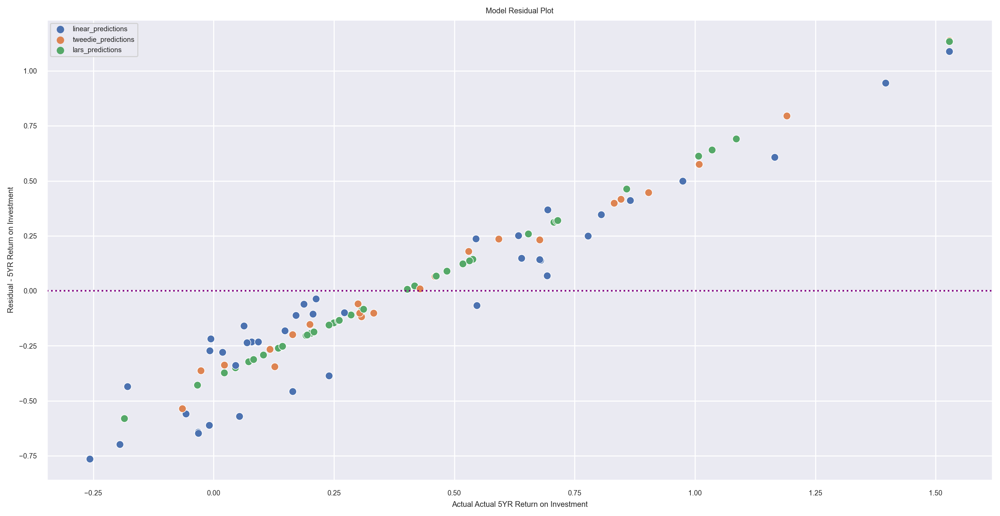

In [103]:
# melting columns for residual plot
melt_df = model.get_melted_table(cluster_predictions)

# plotting model residuals
model.plot_model_residuals(melt_df)

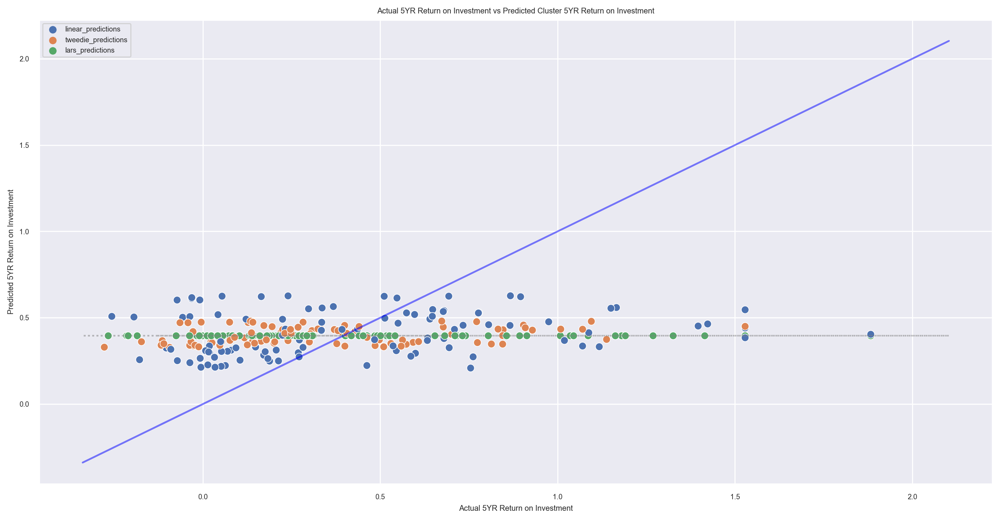

In [104]:
# predicted cluster 5yr roi vs. actual

model.plot_models(melt_df)

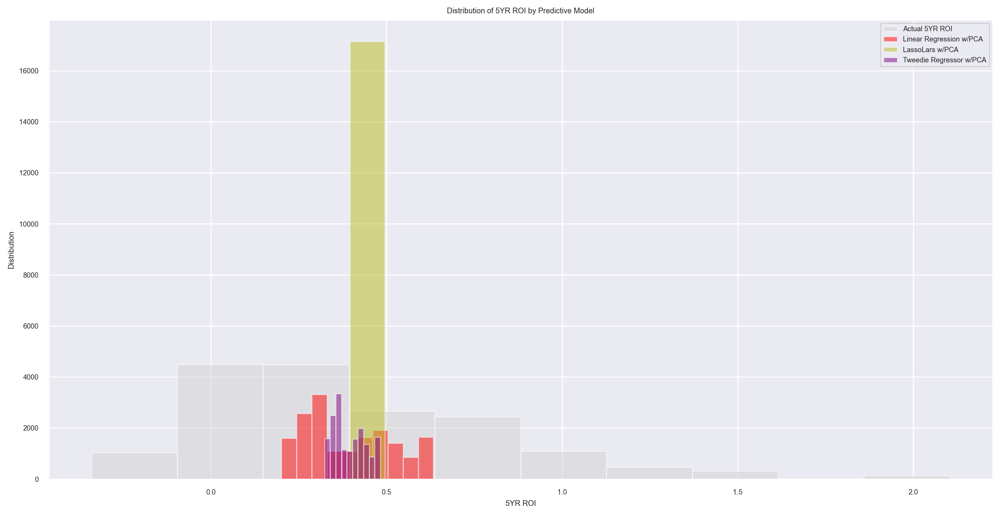

In [105]:
# plotting prediction distribution and evaluating against actual

model.model_distributions(cluster_predictions)

In [106]:
# deploy on test dataset

# generating a dataframe
test_df = pd.DataFrame(y_test_clusters)

pca_clusters = PCA(n_components = 2)
Xtrain_reduced_clusters = pca_clusters.fit_transform(X_train_clusters)

# transforming the test dataset
Xtest_reduced_clusters = pca_clusters.transform(X_test_clusters)

# generating model predictions
test_df["model_predictions"] = regr.predict(Xtest_reduced_clusters)
test_df.head()

,roi_5yr,model_predictions
48405,0.8068,0.452406
39468,0.1232,0.489461
12185,0.1405,0.315591
38075,0.3898,0.501624
32807,0.3899,0.225478


In [107]:
# returning R-squared score & RMSE on test dataset
rmse_test_clusters = sqrt(mean_squared_error(test_df['roi_5yr'], test_df['model_predictions']))

# print('Training R-squared w/Linear Model: {:.3f}'.format(lr_model.score(X_test, y_test)))
print('RMSE on Test Dataset Linear Regression w/PCA Cluster Model: {:.4f}'.format(rmse_test_clusters))

RMSE on Test Dataset Linear Regression w/PCA Cluster Model: 0.3864


**Model Observation**

From the results on out-of-sample, test data we conclude that our Linear Regression w/PCA Cluster Model beat the established baseline.

* **Our model performs ~5% better than baseline**

-----------------------------------------------------------------------------------------------------------
### Summary

Our project entails calculating Return on Investment (ROI) based on College ScoreCard data in conjunction with US Census earnings data. In order to most accurately predict ROI for a given major, we created clusters utilizing PCA. This method resulted in 6 distinct clusters:

1. Admission Rate
2. Institution Control
3. University by US Region
4. Share of First-time, Full-time Students
5. College Majors
6. SAT Score

These 6 clusters used 11 total features from our initial College ScoreCard dataset in order to predict ROI for a given major. The clusters, combined within 6 unique clustering models, led us to ROI predictions calculated using linear regression modeling. 

Our Linear Regression Model with PCA Clustering beat our established baseline by 5%. This prediction can be expressed in Root Mean Square Error (RMSE) as 0.39. This decimal value signifies the potential margin of error of any given prediction (in ROI percentage) in the future on data our model has not seen, given no major changes to our data source.

### Recommendations

We strongly encourage any potential stakeholders who engage with our project to balance our specific finance-related findings within the greater envelope of factors that go into deciding on a college major and specific college. 
Many factors should be included in such a major decision including lifestyle choices, personal interests, passions and aptitudes, desired professional environment, the current economy and job market, and more.
Moreover, we recognize that college is not necessarily the best choice for everyone. The trades and other labor opportunities exist which don't require a college degree and can serve as viable alternatives to our project's focus.

With this in mind, we recommend using our final project deliverables in a variety of ways:

**Final Report** <br>
This Report serves as a complete overview of our data science pipeline. A thorough understanding of our project and its essential processes can be garnered from this document. 

**Tableau Dashboard** <br>
The Dashboard is best used for the decision-making process. A stakeholder can quickly and effectively see a comparison of all majors by ROI, lists of applicable colleges, price, demographics, estimated earnings, and more. We intend this tool to help current and prospective students understand the value and trade-offs of a given college major and its potential career paths in the future. 
This tool holds a wealth of information by major category and allows students to compare and contrast different colleges and majors.

**Whitepaper** <br>
The Whitepaper is a professional snapshot of our whole project and its main emphasis and results. It includes visuals that aid in understanding project scope and key takeaways from our analysis. This document serves stakeholders as a high-level overview for those who don't have time to delve deep into our Final Report and thorough analysis.



### Next Steps
Despite the overall effectiveness of our best-performing model, there is always room for improvement and optimization.
If given more time to pursue better results, we would begin by conducting further exploration and analysis of other features within our dataset. These features could include:

- Carnegie Classification
- Myriad Debt Classifications
- The difference between pell and non-pell debt
- Retention numbers by race
- Share of enrollment by race

In addition, further analysis of alternate clusters could be performed in order to determine whether more effective groupings of variables leads to more accurate predictions in comparison with baseline.  

----

## Appendix

Statistically Tested Features: 

1. Institution Control
2. Major Category
3. US Region
4. Student Family Income Brackets
5. Average Faculty Salary
6. Full-time Student Net Revenue
7. Admission Rate
8. Average Admitted SAT Score
9. Share of First-time, Full-time Students
10. Share of Part-time Students
11. Student Population with Federal Loan(s) and/or Pell Grants


Statistical tests conducted: (include which variables mapped to these tests)

### **Pearson R**

Alpha value: 1 - 0.95 = 0.05 or 5% 


<u>**Variables Tested**</u>

    - avg_faculty_salary
    - admission_rate
    - avg_sat_admitted
    - median_debt_completed

**Is there a relationship between `avg_faculty_salary` and `roi_5yr`?**

- Null Hypothesis: There is no a statistical correlation between avg_faculty_salary and roi_5yr
- Alternative Hypothesis: There is a statistical correlation between avg_faculty_salary and roi_5yr

    We reject the null hypothesis. The value of avg_faculty_salary is correlated with ROI

**Is there a relationship between `admission_rate` and `roi_5yr`?**

- Null Hypothesis: There is no a statistical correlation between admission_rate and roi_5yr
- Alternative Hypothesis: There is a statistical correlation between admission_rate and roi_5yr

    We reject the null hypothesis. The value of admission_rate is correlated with ROI

**Is there a relationship between `avg_sat_admitted` and `roi_5yr`?**

- Null Hypothesis: There is no a statistical correlation between avg_sat_admitted and roi_5yr
- Alternative Hypothesis: There is a statistical correlation between avg_sat_admitted and roi_5yr

    We reject the null hypothesis. The value of avg_sat_admitted is correlated with ROI

**Is there a relationship between `median_debt_completed` and `roi_5yr`?**

- Null Hypothesis: There is no a statistical correlation between median_debt_completed and roi_5yr
- Alternative Hypothesis: There is a statistical correlation between median_debt_completed and roi_5yr

    We reject the null hypothesis. The value of median_debt_completed is correlated with ROI


### **One-way ANOVA**

    Confidence Interval: 95%
    Alpha value: 1 - 0.95 = 0.05 or 5% 

<u>**Variables Tested**</u>

    - US Regions and 5YR ROI
    - Major Categories and 5YR ROI
    - Institution Control and 5YR ROI
    - First-time, Full-time Student Rates (discrete) and 5YR ROI
    - Admission Rates (discrete) and Student Population with Family Income $48-75K
    - Admitted SAT Scores (discrete/binned) and Student Population with Federal Loan(s) and/or Pell Grants


**Is there a difference in ROI earnings across majors?**

- Null Hypothesis: There's not a statistical 5-year Major ROI difference college majors.
- Alternative Hypothesis: There is a statistical 5-year Major ROI difference difference college majors.

    We reject the null hypothesis. Means are different across the groups.

**Is there a difference in ROI earnings across public/private/’other’ controlled institutions?**

- Null Hypothesis: There's not a statistical 5-year Major ROI difference across institution control.
- Alternative Hypothesis: There is a statistical 5-year Major ROI difference difference across institution control.

    We reject the null hypothesis. Means are different across the groups.

**Is there a difference in ROI earnings across university first-time, full-time student percentage?**

- Null Hypothesis: There's not a statistical 5-year ROI difference across a univertity's first-time, full-time student enrollment %.
- Alternative Hypothesis: There is a statistical 5-year ROI difference across a univertity's first-time, full-time student enrollment %

    We reject the null hypothesis. Means are different across the groups.

**Is there a difference in ROI earnings across university regions?**

- Null Hypothesis: There's not a statistical 5-year ROI difference across a univertity's US region.
- Alternative Hypothesis: There is a statistical 5-year ROI difference across a univertity's US region.

    We reject the null hypothesis. Means are different across the groups.

**Is there a difference across university admission rates (discrete/binned) and student population family income $48-75K?**

- Null Hypothesis: There's not a statistical difference across discrete admission rates and student population with family income $48-75K.
- Alternative Hypothesis: There is a statistical difference across discrete admission rates and student population with family income $48-75K.

    We reject the null hypothesis. Means are different across the groups.

**Is there a difference across admitted SAT score rates (discrete/binned) and student population with federal loans and/or pell grants?**

- Null Hypothesis: There's not a statistical difference across discrete admitted SAT rates and student population with federal loans and/or pell grants.
- Alternative Hypothesis: There is a statistical difference across discrete admitted SAT rates and student population with federal loans and/or pell grants.

    We reject the null hypothesis. Means are different across the groups.
